clean data
- clean -> fill negative increase with 0
- try smooth daily increase
number of peaks
- exclude small peaks -> less than 10% of max?
latest 7 (or 3) days mean vs latest 15 (or 30) days mean
forecast -> time s.t. area = 97% of pop

In [1]:
import numpy as np
import pandas as pd
import scipy
from datetime import date, timedelta
from scipy import signal
from reliability.Distributions import Weibull_Distribution
from reliability.Fitters import Fit_Weibull_Mixture, Fit_Weibull_2P, Fit_Weibull_3P, Fit_Everything
import matplotlib.pyplot as plt

In [2]:
df = pd.read_csv('COVID-19/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv')
df

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,9/14/20,9/15/20,9/16/20,9/17/20,9/18/20,9/19/20,9/20/20,9/21/20,9/22/20,9/23/20
0,NaN,Afghanistan,33.939110,67.709953,0,0,0,0,0,0,...,38772,38815,38855,38872,38883,38919,39044,39074,39096,39145
1,NaN,Albania,41.153300,20.168300,0,0,0,0,0,0,...,11520,11672,11816,11948,12073,12226,12385,12535,12666,12787
2,NaN,Algeria,28.033900,1.659600,0,0,0,0,0,0,...,48496,48734,48966,49194,49413,49623,49826,50023,50214,50400
3,NaN,Andorra,42.506300,1.521800,0,0,0,0,0,0,...,1438,1438,1483,1483,1564,1564,1564,1681,1681,1753
4,NaN,Angola,-11.202700,17.873900,0,0,0,0,0,0,...,3439,3569,3675,3789,3848,3901,3991,4117,4236,4363
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
261,NaN,West Bank and Gaza,31.952200,35.233200,0,0,0,0,0,0,...,31362,32250,33006,33843,34401,35003,35686,36151,36580,37083
262,NaN,Western Sahara,24.215500,-12.885800,0,0,0,0,0,0,...,10,10,10,10,10,10,10,10,10,10
263,NaN,Yemen,15.552727,48.516388,0,0,0,0,0,0,...,2013,2016,2019,2022,2024,2026,2026,2028,2028,2029
264,NaN,Zambia,-13.133897,27.849332,0,0,0,0,0,0,...,13720,13819,13887,13928,14022,14070,14131,14175,14389,14443


In [3]:
df_by_country = df.groupby('Country/Region').sum()
df_by_country_sum = df_by_country.T.drop(['Lat','Long']).reset_index().rename(columns={'index':'Date'}).set_index('Date')
df_by_country_increase = df_by_country_sum-df_by_country_sum.shift(1).fillna(0)
df_by_country_increase[df_by_country_increase<0] = 0
df_by_country_increase

Country/Region,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,Austria,...,United Kingdom,Uruguay,Uzbekistan,Venezuela,Vietnam,West Bank and Gaza,Western Sahara,Yemen,Zambia,Zimbabwe
Date,,,,,,,,,,,,,,,,,,,,,
1/22/20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1/23/20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0
1/24/20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1/25/20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1/26/20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9/19/20,36.0,153.0,210.0,0.0,53.0,1.0,9276.0,244.0,13.0,813.0,...,4429.0,14.0,739.0,775.0,0.0,602.0,0.0,2.0,48.0,25.0
9/20/20,125.0,159.0,203.0,0.0,90.0,0.0,8431.0,277.0,14.0,621.0,...,3899.0,13.0,648.0,707.0,0.0,683.0,0.0,0.0,61.0,11.0
9/21/20,30.0,150.0,197.0,117.0,126.0,0.0,8782.0,121.0,30.0,563.0,...,4378.0,10.0,430.0,787.0,0.0,465.0,0.0,2.0,44.0,0.0


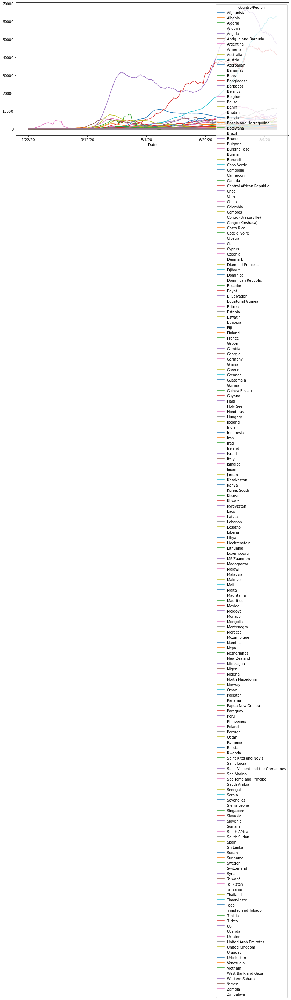

In [31]:
# df_by_country_increase.rolling(window=7).mean().fillna(0).plot(kind='line',figsize=(14,7))

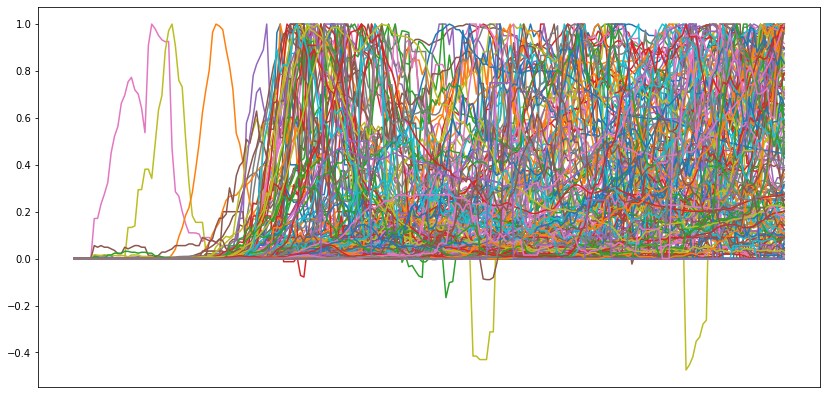

In [28]:
# plt.figure(figsize=(14,7))
# for i in range(len(df_by_country_increase.columns.values)):
#     df_country = df_by_country_increase[[df_by_country_increase.columns.values[i]]].rolling(window=7).mean().fillna(0)
#     plt.plot(df_country/df_country.max())
#     plt.xticks([])

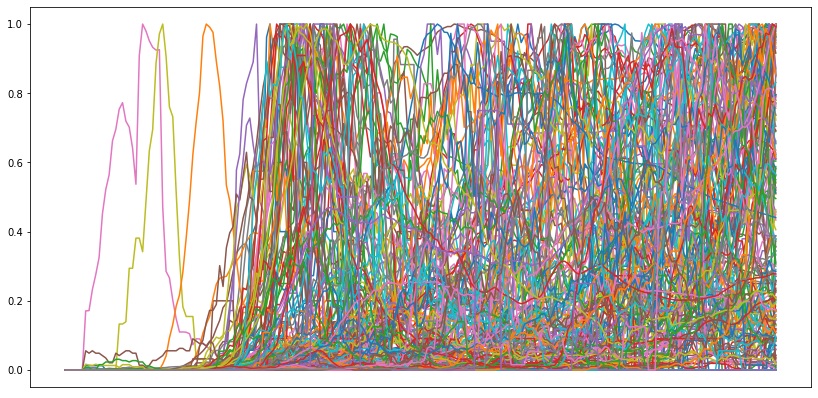

In [8]:
# plt.figure(figsize=(14,7))
# for i in range(len(df_by_country_increase.columns.values)):
#     df_country = df_by_country_increase[[df_by_country_increase.columns.values[i]]].rolling(window=7).mean().fillna(0)
#     plt.plot(df_country/df_country.max())
#     plt.xticks([])

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

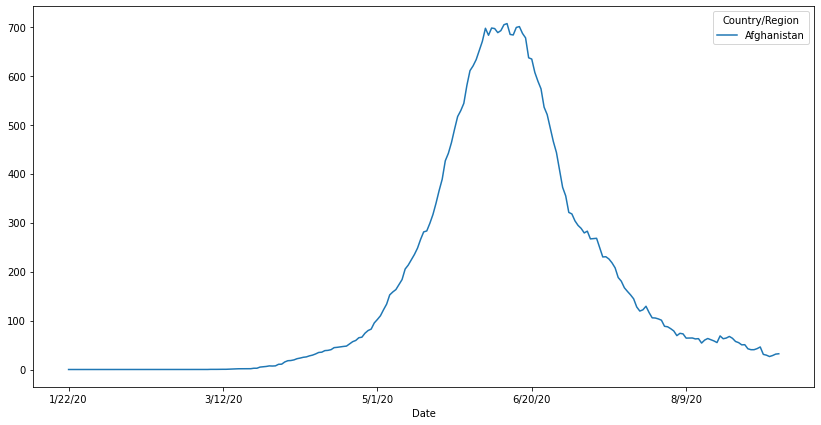

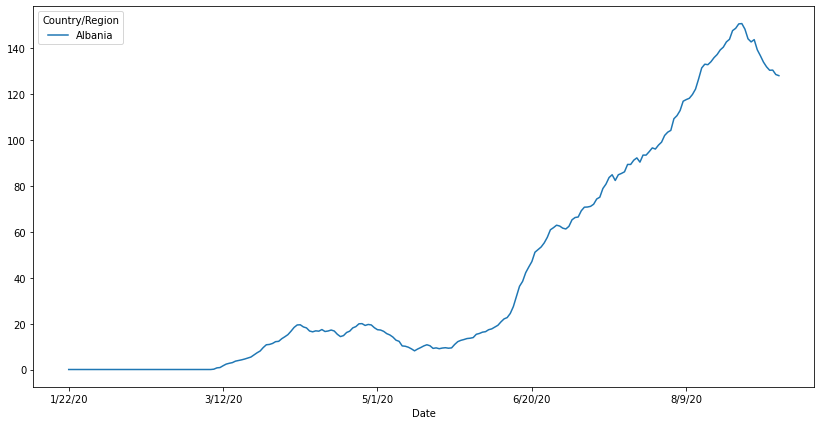

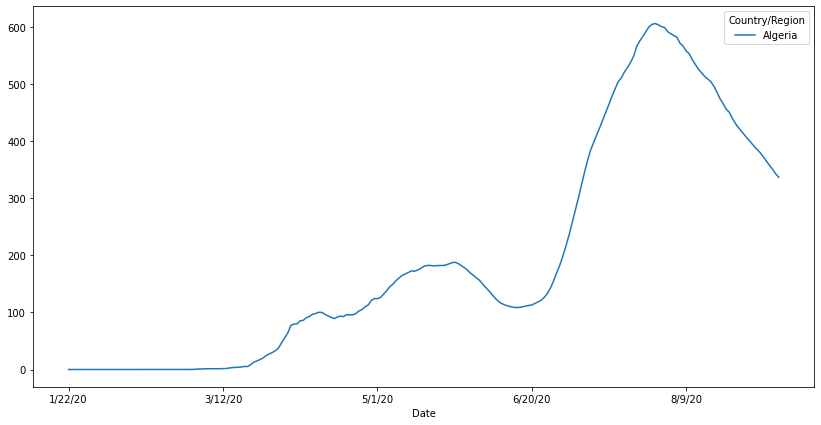

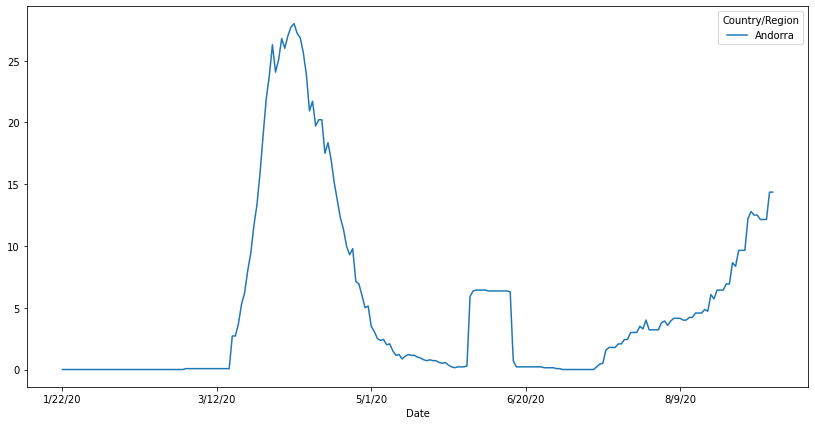

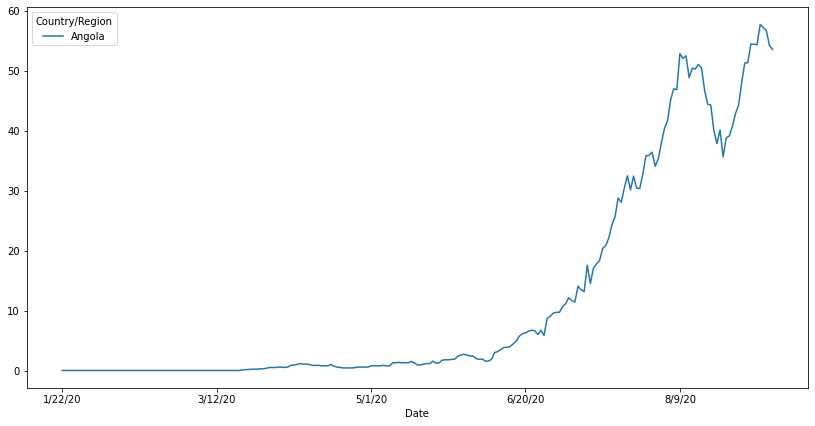

...

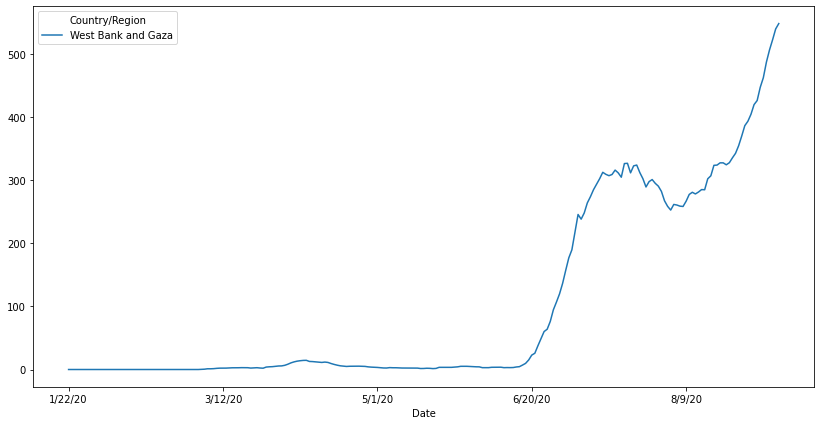

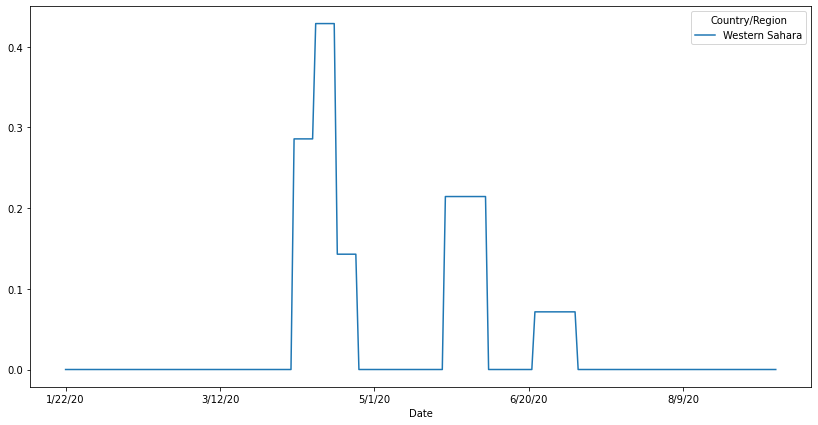

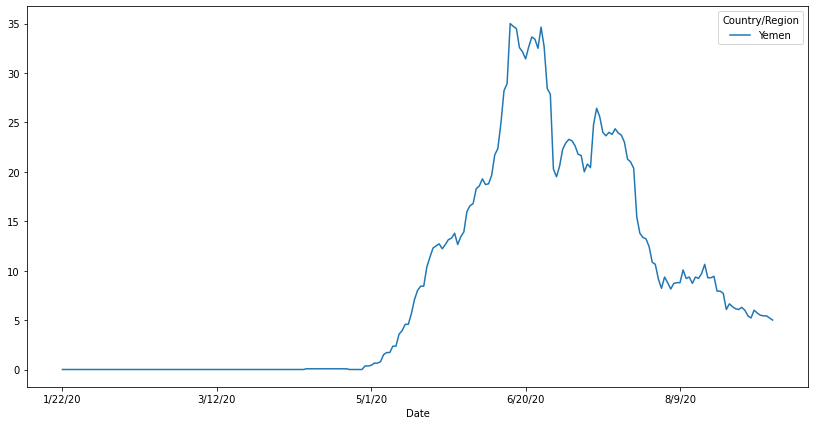

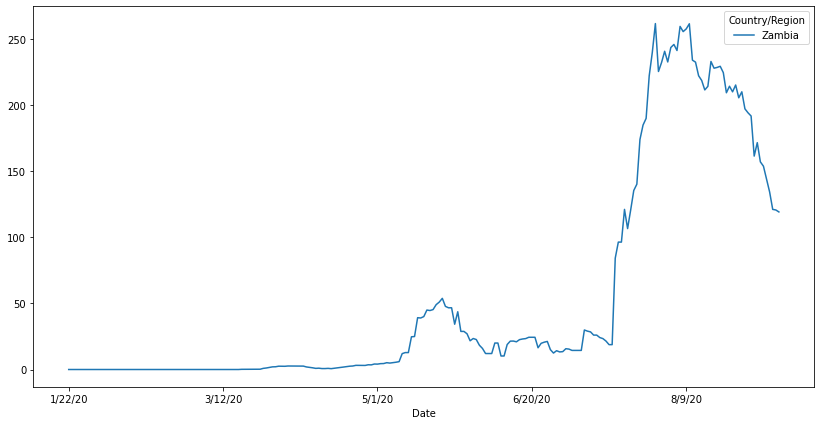

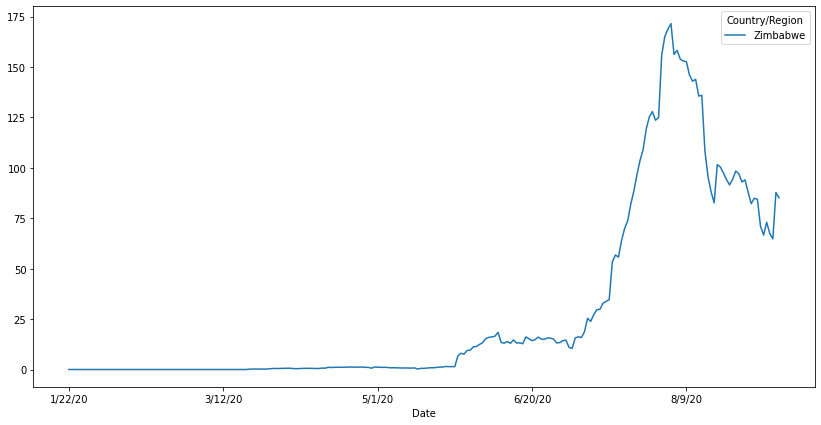

In [11]:
# for country in df_by_country_increase.columns.values:
#     df_by_country_increase[[country]].rolling(window=14).mean().fillna(0).plot(kind='line',figsize=(14,7))
#     plt.savefig('./output-no-neg-incr-roll14/'+country+'.jpg')

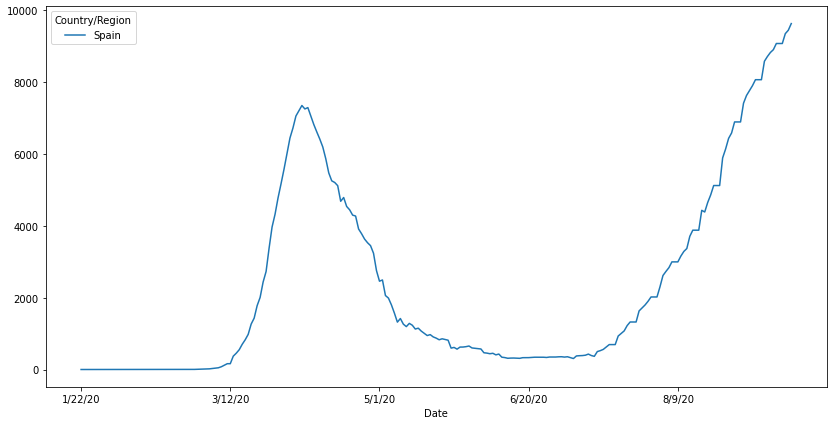

In [7]:
# df_by_country_increase[['Spain']].rolling(window=14).mean().fillna(0).plot(kind='line',figsize=(14,7))

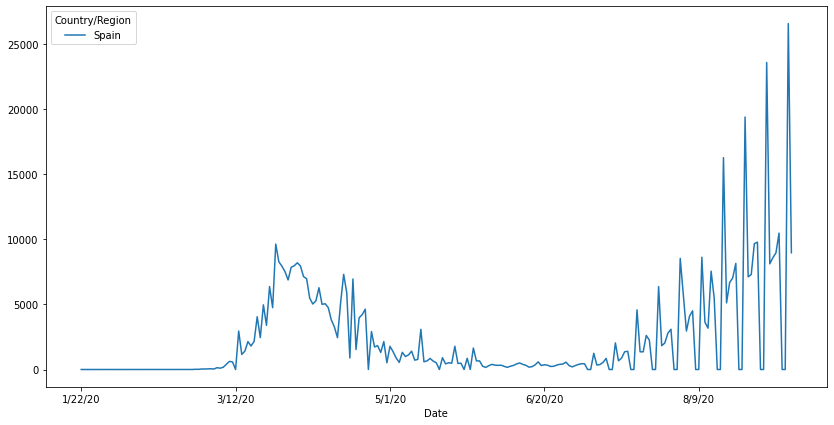

In [8]:
# df_by_country_increase[['Spain']].fillna(0).plot(kind='line',figsize=(14,7))

In [9]:
# df_by_country_increase[['Spain']]

Country/Region,Spain
Date,
1/22/20,0.0
1/23/20,0.0
1/24/20,0.0
1/25/20,0.0
1/26/20,0.0
...,...
8/22/20,0.0
8/23/20,0.0
8/24/20,19382.0


In [10]:
# df_by_country_increase[['Spain']].iloc[signal.find_peaks(df_by_country_increase['Spain'].rolling(window=14).mean(),width=14)[0]]

Country/Region,Spain
Date,
4/5/20,5478.0


In [8]:
# df_by_country_increase[['US']].iloc[182]

Country/Region
US    70910.0
Name: 7/22/20, dtype: float64

In [77]:
# signal.find_peaks(df_by_country_increase['US'].rolling(window=7).mean(),width=7)

(array([ 79, 182]),
 {'prominences': array([11265.42857143, 15135.28571429]),
  'left_bases': array([29, 29]),
  'right_bases': array([139, 204]),
  'widths': array([34.39398343, 22.28476918]),
  'width_heights': array([25995.28571429, 59749.35714286]),
  'left_ips': array([ 72.57609102, 172.31044033]),
  'right_ips': array([106.97007446, 194.59520951])})

In [75]:
# signal.find_peaks(np.arange(0,100)**2,width=7)

(array([], dtype=int64),
 {'prominences': array([], dtype=float64),
  'left_bases': array([], dtype=int64),
  'right_bases': array([], dtype=int64),
  'widths': array([], dtype=float64),
  'width_heights': array([], dtype=float64),
  'left_ips': array([], dtype=float64),
  'right_ips': array([], dtype=float64)})

In [89]:
# ((df_by_country_increase[-15:].mean()+1)/(df_by_country_increase[-30:].mean()+1)).sort_values()

Country/Region
Equatorial Guinea        0.092923
Sao Tome and Principe    0.295858
South Sudan              0.460064
Egypt                    0.509717
Azerbaijan               0.510355
                           ...   
New Zealand              1.550388
Tunisia                  1.594796
Trinidad and Tobago      1.751295
Belize                   1.882136
Jordan                   1.889273
Length: 188, dtype: float64

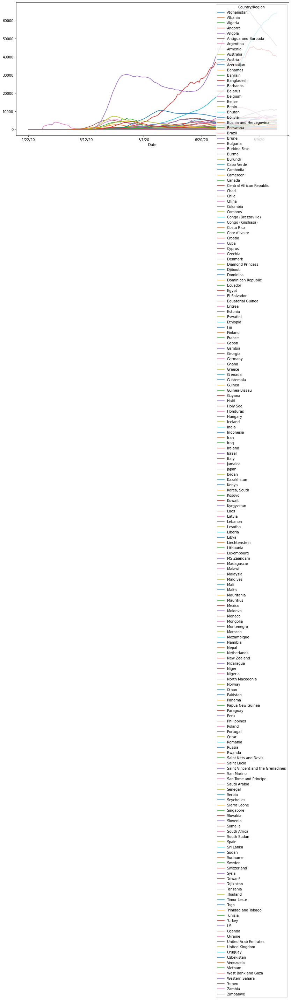

In [25]:
# df_by_country_increase.rolling(window=14).mean().fillna(0).plot(kind='line',figsize=(14,7))

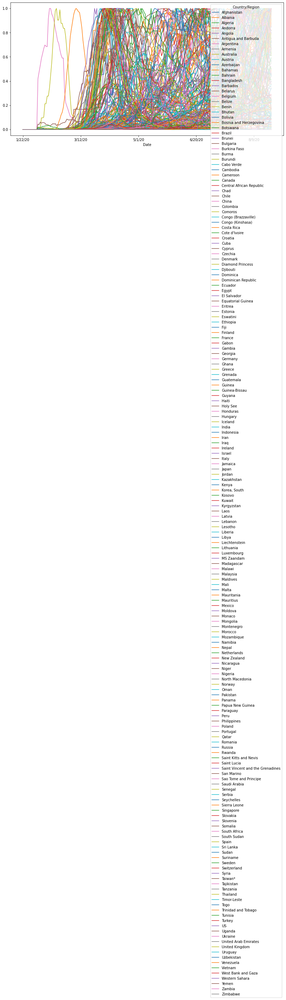

In [27]:
# df_by_country_increase_rolling_scale.plot(kind='line',figsize=(14,7))

In [28]:
# df_by_country_increase_rolling_scale

Country/Region,Afghanistan,Albania,Algeria,Andorra,Angola,Antigua and Barbuda,Argentina,Armenia,Australia,Austria,...,United Kingdom,Uruguay,Uzbekistan,Venezuela,Vietnam,West Bank and Gaza,Western Sahara,Yemen,Zambia,Zimbabwe
Date,,,,,,,,,,,,,,,,,,,,,
1/22/20,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
1/23/20,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
1/24/20,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
1/25/20,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
1/26/20,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8/20/20,0.097097,0.942968,0.782445,0.204082,0.758108,0.044444,0.955567,0.299473,0.612774,0.299365,...,0.217163,0.624585,0.914512,0.980644,0.606132,0.976185,0.0,0.269388,0.876503,0.585589
8/21/20,0.088905,0.951184,0.768287,0.229592,0.716216,0.044444,0.962546,0.298515,0.578542,0.320162,...,0.219574,0.634551,0.893214,0.964582,0.518868,0.976185,0.0,0.226531,0.858197,0.568097
8/22/20,0.090927,0.966651,0.752124,0.229592,0.759459,0.044444,0.979299,0.291207,0.552312,0.344024,...,0.228121,0.617940,0.879643,0.960670,0.476415,0.967042,0.0,0.226531,0.800000,0.548938


In [51]:
# pd.DataFrame({
#     'country':df_by_country_increase_rolling_scale.columns,
# }).set_index('country')

""
country
Afghanistan
Albania
Algeria
Andorra
Angola
...
West Bank and Gaza
Western Sahara
Yemen


In [72]:
# # 26/8/2020
# [signal.find_peaks(df_by_country_increase_rolling_scale[country],
#                           width=14)[0] for country in df_by_country_increase_rolling_scale.columns]

[array([142]),
 array([95]),
 array([125, 190]),
 array([ 75, 135]),
 array([], dtype=int64),
 array([ 76,  83, 136, 167]),
 array([], dtype=int64),
 array([166]),
 array([ 72, 198]),
 array([72]),
 array([ 83, 167]),
 array([80]),
 array([165]),
 array([159]),
 array([ 78, 149]),
 array([124]),
 array([19, 84]),
 array([83]),
 array([155, 157]),
 array([137]),
 array([187]),
 array([80]),
 array([91]),
 array([195]),
 array([ 62,  64, 112]),
 array([105, 189]),
 array([78]),
 array([93]),
 array([102, 163, 185]),
 array([], dtype=int64),
 array([ 68, 158, 185, 193]),
 array([150]),
 array([102]),
 array([147, 159]),
 array([117, 196]),
 array([142]),
 array([ 23,  71, 195]),
 array([], dtype=int64),
 array([153, 199]),
 array([180]),
 array([159]),
 array([71]),
 array([157]),
 array([ 72, 183]),
 array([90]),
 array([80]),
 array([77]),
 array([80]),
 array([29, 62]),
 array([ 90, 132]),
 array([ 73, 138]),
 array([192]),
 array([], dtype=int64),
 array([ 29, 156]),
 array([201]),
 a

In [13]:
# [signal.find_peaks(df_by_country_increase_rolling_scale[country],
#                           width=14)[0] for country in df_by_country_increase_rolling_scale.columns]

[array([142]),
 array([95]),
 array([125, 190]),
 array([ 75, 135]),
 array([], dtype=int64),
 array([ 76,  83, 136, 167]),
 array([], dtype=int64),
 array([166]),
 array([ 72, 198]),
 array([72]),
 array([ 83, 167]),
 array([80]),
 array([165]),
 array([159]),
 array([ 78, 149]),
 array([124]),
 array([19, 84]),
 array([83]),
 array([155, 157]),
 array([137]),
 array([187]),
 array([80]),
 array([91]),
 array([195]),
 array([ 62,  64, 112]),
 array([105, 189]),
 array([78]),
 array([93]),
 array([102, 163, 185]),
 array([], dtype=int64),
 array([ 68, 158, 185, 193]),
 array([150]),
 array([102]),
 array([147, 159]),
 array([117, 196]),
 array([142]),
 array([ 23,  71, 195]),
 array([], dtype=int64),
 array([153, 199]),
 array([180]),
 array([159]),
 array([71]),
 array([157]),
 array([ 72, 183]),
 array([90]),
 array([80]),
 array([77]),
 array([80]),
 array([29, 62]),
 array([ 90, 132]),
 array([ 73, 138]),
 array([192]),
 array([], dtype=int64),
 array([ 29, 156]),
 array([201]),
 a

In [159]:
# # 26/8/2020
# df_country_peaks = pd.DataFrame({
#     'country':df_by_country_increase_rolling.columns,
#     'peaks_index':[
#         signal.find_peaks(
#             df_by_country_increase_rolling[country], width=14
#         )[0] for country in df_by_country_increase_rolling.columns
#     ]
# })
# df_country_peaks['peaks_date'] = df_country_peaks['peaks_index'].apply(
#     lambda x: df_by_country_increase.iloc[x].index.tolist()
# )
# df_country_peaks['peaks_case'] = df_country_peaks[['country','peaks_date']].T.apply(
#     lambda x: df_by_country_increase_rolling.T.loc[x[0]][x[1]].tolist()
# )
# df_country_peaks['peaks_case_filter'] = df_country_peaks['peaks_case'].apply(
#     lambda x: [i for i in x if i > 100]
# )
# df_country_peaks['no_peaks'] = df_country_peaks['peaks_case_filter'].apply(lambda x: len(x))
# df_country_peaks

,country,peaks_index,peaks_date,peaks_case,peaks_case_filter,no_peaks
0,Afghanistan,[142],[6/12/20],[706.2142857142857],[706.2142857142857],1
1,Albania,[95],[4/26/20],[20.0],[],0
2,Algeria,"[125, 190]","[5/26/20, 7/30/20]","[187.85714285714286, 605.4285714285714]","[187.85714285714286, 605.4285714285714]",2
3,Andorra,"[75, 135]","[4/6/20, 6/5/20]","[28.0, 6.428571428571429]",[],0
4,Angola,[],[],[],[],0
...,...,...,...,...,...,...
183,West Bank and Gaza,"[77, 181]","[4/8/20, 7/21/20]","[14.571428571428571, 327.2142857142857]",[327.2142857142857],1
184,Western Sahara,"[84, 129, 158]","[4/15/20, 5/30/20, 6/28/20]","[0.42857142857142855, 0.21428571428571427, 0.0...",[],0
185,Yemen,"[85, 145]","[4/16/20, 6/15/20]","[0.07142857142857142, 35.0]",[],0
186,Zambia,[121],[5/22/20],[53.785714285714285],[],0


In [168]:
# # 26/8/2020
# print(df_country_peaks[['country','peaks_case_filter']].to_string())

                              country                                            peaks_case_filter
0                         Afghanistan                                          [706.2142857142857]
1                             Albania                                                           []
2                             Algeria                      [187.85714285714286, 605.4285714285714]
3                             Andorra                                                           []
4                              Angola                                                           []
5                 Antigua and Barbuda                                                           []
6                           Argentina                                                           []
7                             Armenia                                          [596.2857142857143]
8                           Australia                                   [324.2142857142857, 482.0]
9         

In [58]:
# # 28/8/2020
# df_by_country_increase_rolling = df_by_country_increase.rolling(window=14).mean().fillna(0)
# # df_by_country_increase_rolling_scale = (df_by_country_increase_rolling-df_by_country_increase_rolling.min())/(df_by_country_increase_rolling.max()-df_by_country_increase_rolling.min())
# # df_by_country_increase_rolling_scale.columns
# df_country_peaks = pd.DataFrame({
#     'country':df_by_country_increase_rolling.columns,
#     'peaks_index':[
#         signal.find_peaks(
#             df_by_country_increase_rolling[country], width=7
#         )[0] for country in df_by_country_increase_rolling.columns
#     ],
#     'incr_ratio_2w_now': (df_by_country_increase_rolling[-14:].mean()+1)/(df_by_country_increase_rolling[-60:-14].mean()+1),
# #     'increasing_ratio_4w_2w': (df_by_country_increase_rolling[-30:].mean()+1)/(df_by_country_increase_rolling[-60:-30].mean()+1)
# })
# df_country_peaks['peaks_date'] = df_country_peaks['peaks_index'].apply(
#     lambda x: df_by_country_increase.iloc[x].index.tolist()
# )
# df_country_peaks['peaks_case'] = df_country_peaks[['country','peaks_date']].T.apply(
#     lambda x: df_by_country_increase_rolling.T.loc[x[0]][x[1]].tolist()
# )
# df_country_peaks['peaks_case_zip'] = df_country_peaks[['peaks_index','peaks_date','peaks_case']].T.apply(
#     lambda x: list(zip(x[0],x[1],x[2]))
# )
# df_country_peaks['current_growth'] = df_country_peaks[['peaks_index','peaks_date','peaks_case']].T.apply(
#     lambda x: list(zip(x[0],x[1],x[2]))
# )
# df_country_peaks['peaks_case_filter'] = df_country_peaks['peaks_case_zip'].apply(
#     lambda x: [i for i in x if i[2] > 100 and i[2] > 0.2*max(x, key=lambda y: y[2])[2]]
# )
# df_country_peaks.loc[(df_country_peaks['incr_ratio_2w_now']<0.6), 'trend'] = 'Decreasing'
# df_country_peaks.loc[(df_country_peaks['incr_ratio_2w_now']>1.6), 'trend'] = 'Increasing'
# df_country_peaks.loc[df_country_peaks['incr_ratio_2w_now'].between(0.6, 1.6), 'trend'] = 'Constant/Inconclusive'
# df_country_peaks['no_peaks'] = df_country_peaks['peaks_case_filter'].apply(lambda x: len(x))
# df_country_peaks

,country,peaks_index,incr_ratio_2w_now,peaks_date,peaks_case,peaks_case_zip,current_growth,peaks_case_filter,trend,no_peaks
Country/Region,,,,,,,,,,
Afghanistan,Afghanistan,[142],0.327681,[6/12/20],[706.2142857142857],"[(142, 6/12/20, 706.2142857142857)]","[(142, 6/12/20, 706.2142857142857)]","[(142, 6/12/20, 706.2142857142857)]",Decreasing,1
Albania,Albania,[95],1.575010,[4/26/20],[20.0],"[(95, 4/26/20, 20.0)]","[(95, 4/26/20, 20.0)]",[],Constant/Inconclusive,0
Algeria,Algeria,"[125, 190]",1.020492,"[5/26/20, 7/30/20]","[187.85714285714286, 605.4285714285714]","[(125, 5/26/20, 187.85714285714286), (190, 7/3...","[(125, 5/26/20, 187.85714285714286), (190, 7/3...","[(125, 5/26/20, 187.85714285714286), (190, 7/3...",Constant/Inconclusive,2
Andorra,Andorra,"[75, 135]",2.296894,"[4/6/20, 6/5/20]","[28.0, 6.428571428571429]","[(75, 4/6/20, 28.0), (135, 6/5/20, 6.428571428...","[(75, 4/6/20, 28.0), (135, 6/5/20, 6.428571428...",[],Increasing,0
Angola,Angola,"[77, 113, 200]",1.578632,"[4/8/20, 5/14/20, 8/9/20]","[1.1428571428571428, 1.5, 52.857142857142854]","[(77, 4/8/20, 1.1428571428571428), (113, 5/14/...","[(77, 4/8/20, 1.1428571428571428), (113, 5/14/...",[],Constant/Inconclusive,0
...,...,...,...,...,...,...,...,...,...,...
West Bank and Gaza,West Bank and Gaza,"[77, 128, 181]",1.184662,"[4/8/20, 5/29/20, 7/21/20]","[14.571428571428571, 5.071428571428571, 327.21...","[(77, 4/8/20, 14.571428571428571), (128, 5/29/...","[(77, 4/8/20, 14.571428571428571), (128, 5/29/...","[(181, 7/21/20, 327.2142857142857)]",Constant/Inconclusive,1
Western Sahara,Western Sahara,"[84, 129, 158]",0.987730,"[4/15/20, 5/30/20, 6/28/20]","[0.42857142857142855, 0.21428571428571427, 0.0...","[(84, 4/15/20, 0.42857142857142855), (129, 5/3...","[(84, 4/15/20, 0.42857142857142855), (129, 5/3...",[],Constant/Inconclusive,0
Yemen,Yemen,"[85, 145, 173]",0.498864,"[4/16/20, 6/15/20, 7/13/20]","[0.07142857142857142, 35.0, 26.428571428571427]","[(85, 4/16/20, 0.07142857142857142), (145, 6/1...","[(85, 4/16/20, 0.07142857142857142), (145, 6/1...",[],Decreasing,0


In [38]:
# # 28/8/2020
# print(df_country_peaks[df_country_peaks['incr_ratio_2w_now']>1.6].sort_values(by='incr_ratio_2w_now')[['country','incr_ratio_2w_now']].to_string())

                                 country  incr_ratio_2w_now
Country/Region                                             
Rwanda                            Rwanda           1.613020
Georgia                          Georgia           1.633873
Romania                          Romania           1.666114
Monaco                            Monaco           1.671906
Argentina                      Argentina           1.698615
Costa Rica                    Costa Rica           1.743807
Colombia                        Colombia           1.750810
Zambia                            Zambia           1.756559
Ukraine                          Ukraine           1.763118
Peru                                Peru           1.773013
India                              India           1.802874
Poland                            Poland           1.836635
Botswana                        Botswana           1.951774
Nepal                              Nepal           1.966680
Japan                              Japan

In [39]:
# print(df_country_peaks[df_country_peaks['incr_ratio_2w_now']<0.6].sort_values(by='incr_ratio_2w_now')[['country','incr_ratio_2w_now']].to_string())

                                           country  incr_ratio_2w_now
Country/Region                                                       
Central African Republic  Central African Republic           0.104936
Egypt                                        Egypt           0.161617
Oman                                          Oman           0.206835
Equatorial Guinea                Equatorial Guinea           0.208826
Pakistan                                  Pakistan           0.281202
Azerbaijan                              Azerbaijan           0.288696
Cote d'Ivoire                        Cote d'Ivoire           0.292728
Afghanistan                            Afghanistan           0.327681
Kazakhstan                              Kazakhstan           0.332888
Somalia                                    Somalia           0.340318
Sri Lanka                                Sri Lanka           0.344599
Liberia                                    Liberia           0.351236
Mauritania          

In [53]:
# print(df_country_peaks[df_country_peaks['incr_ratio_2w_now'].between(0.6,1.6)].sort_values(by='incr_ratio_2w_now')[['country','incr_ratio_2w_now']].to_string())

                                                           country  incr_ratio_2w_now
Country/Region                                                                       
Niger                                                        Niger           0.621696
Mali                                                          Mali           0.640797
Chile                                                        Chile           0.653595
Serbia                                                      Serbia           0.694065
Luxembourg                                              Luxembourg           0.702087
Nicaragua                                                Nicaragua           0.707609
Portugal                                                  Portugal           0.709075
Nigeria                                                    Nigeria           0.716321
Sudan                                                        Sudan           0.719097
Malawi                                                

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/home/samuraiwarm/.local/lib/python3.6/site-packages/pandas/plotting/_matplotlib/core.py:320: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplo

<Figure size 1008x504 with 0 Axes>

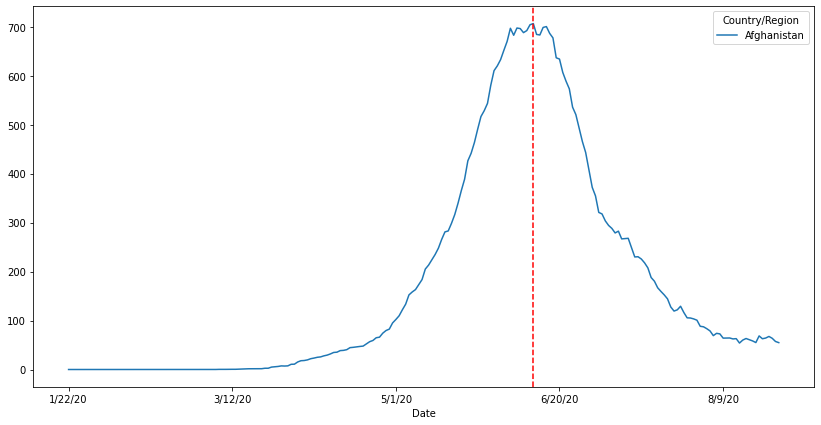

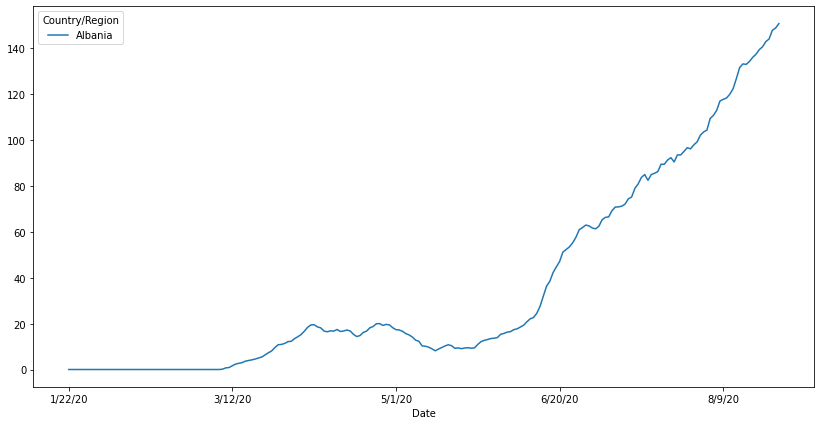

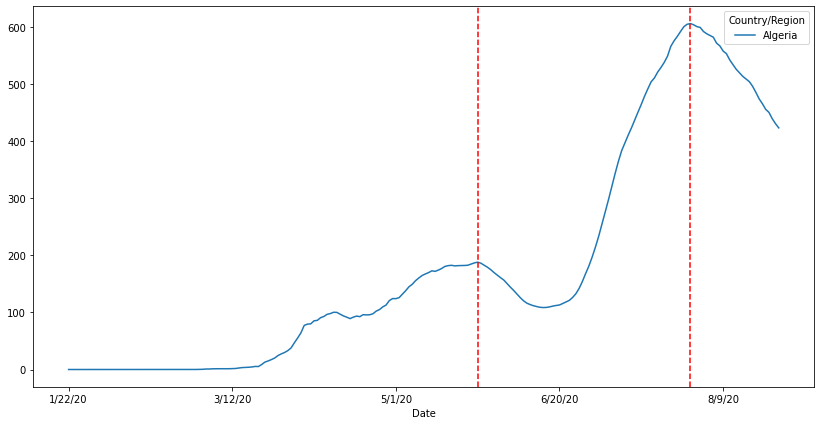

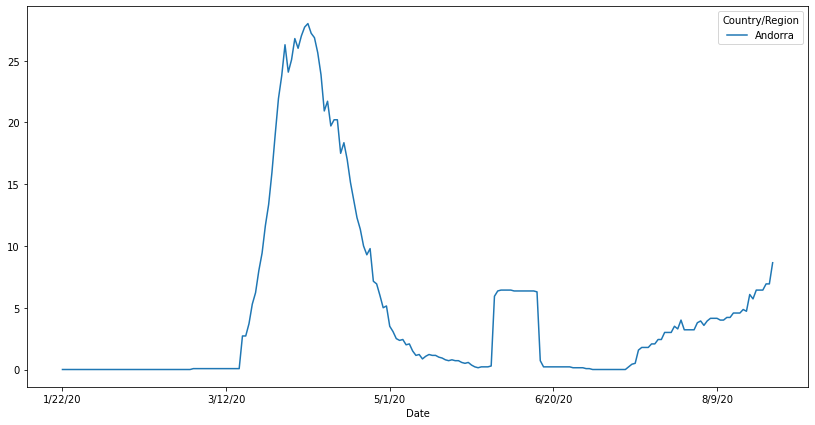

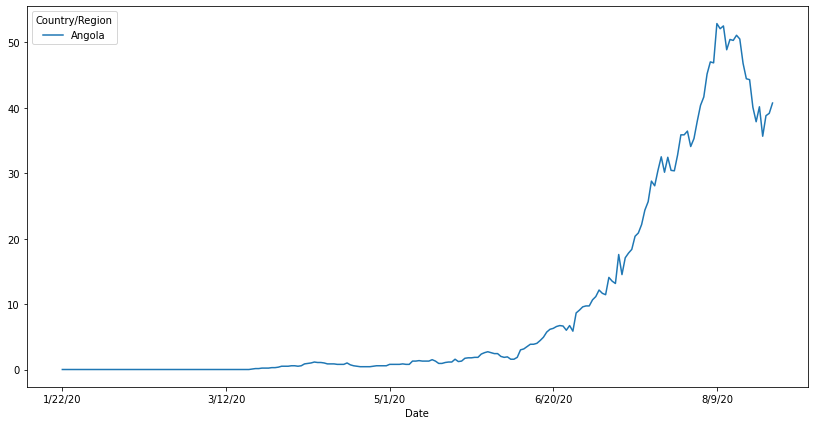

...

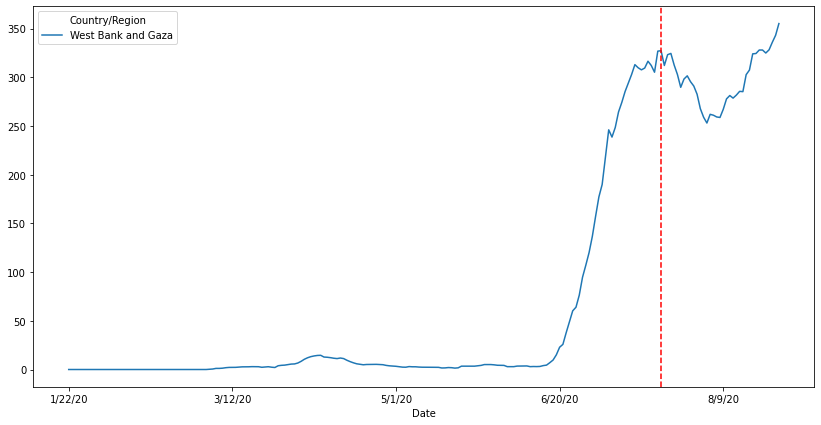

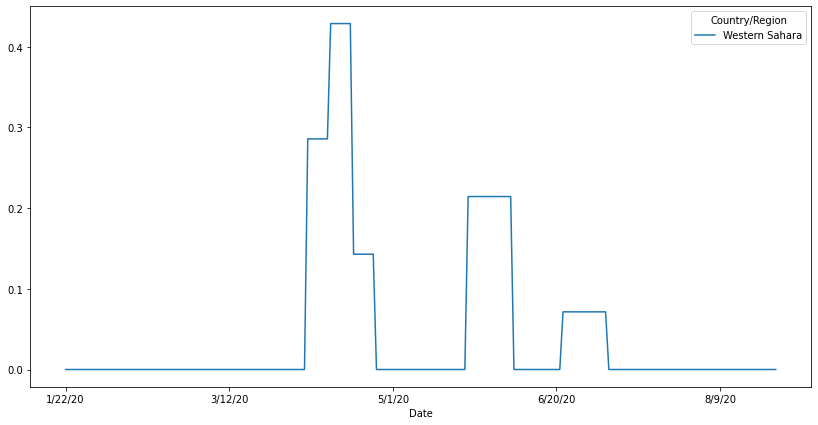

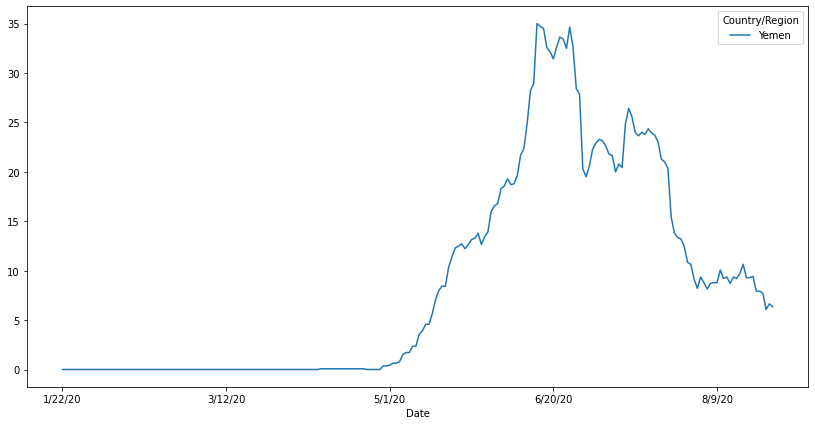

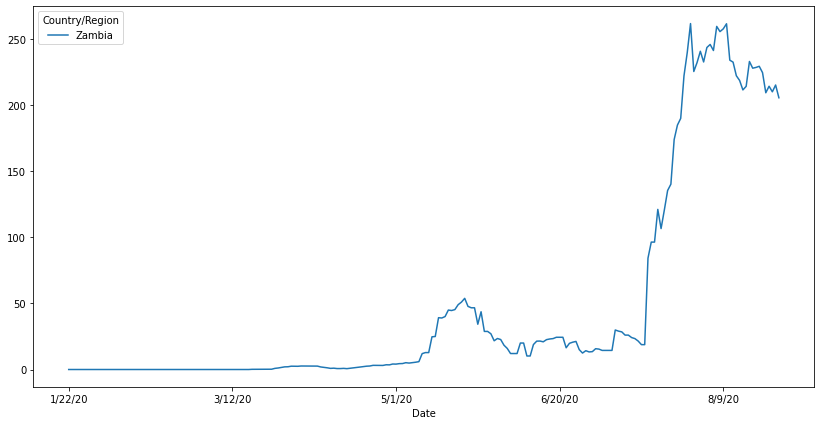

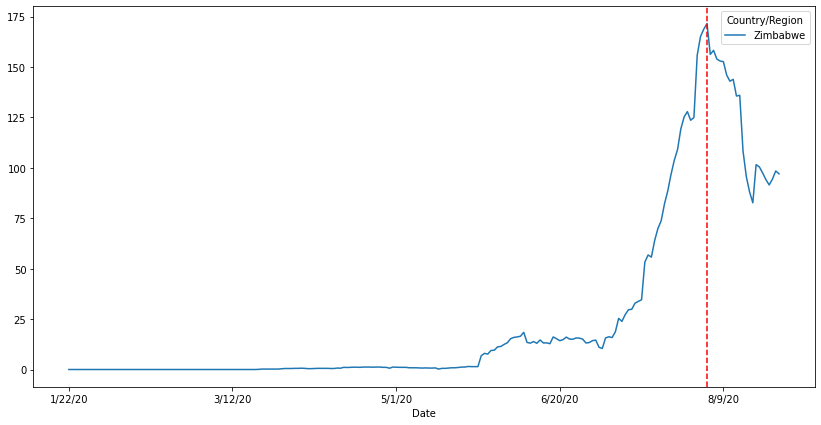

In [21]:
# plt.figure(figsize=(14,7))
# for country in df_by_country_increase.columns.values:
#     df_by_country_increase[[country]].rolling(window=14).mean().fillna(0).plot(kind='line',figsize=(14,7))
#     for peak in df_country_peaks.loc[[country]]['peaks_case_filter'].values[0]:
#         plt.axvline(x=peak[0],color='r',linestyle='--')
#     plt.savefig('./output-no-neg-incr-roll14/'+country+'.jpg')

In [135]:
df_by_country_increase_rolling = df_by_country_increase.rolling(window=14).mean().fillna(0)
df_by_country_increase_rolling_scale = (df_by_country_increase_rolling-df_by_country_increase_rolling.min())/(df_by_country_increase_rolling.max()-df_by_country_increase_rolling.min())
# df_by_country_increase_rolling_scale.columns
df_country_peaks = pd.DataFrame({
    'country':df_by_country_increase_rolling.columns,
    'peaks_index':[
        signal.find_peaks(
            df_by_country_increase_rolling[country], width=7
        )[0] for country in df_by_country_increase_rolling.columns
    ],
    'incr_ratio_2w_now': (df_by_country_increase_rolling[-14:].mean()+1)/(df_by_country_increase_rolling[-60:-14].mean()+1),
#     'increasing_ratio_4w_2w': (df_by_country_increase_rolling[-30:].mean()+1)/(df_by_country_increase_rolling[-60:-30].mean()+1)
})
df_country_peaks['peaks_date'] = df_country_peaks['peaks_index'].apply(
    lambda x: df_by_country_increase.iloc[x].index.tolist()
)
df_country_peaks['peaks_case'] = df_country_peaks[['country','peaks_date']].T.apply(
    lambda x: df_by_country_increase_rolling.T.loc[x[0]][x[1]].tolist()
)
df_country_peaks['peaks_case_zip'] = df_country_peaks[['peaks_index','peaks_date','peaks_case']].T.apply(
    lambda x: list(zip(x[0],x[1],x[2]))
)
df_country_peaks['current_growth'] = df_country_peaks[['peaks_index','peaks_date','peaks_case']].T.apply(
    lambda x: list(zip(x[0],x[1],x[2]))
)
df_country_peaks['peaks_case_filter'] = df_country_peaks['peaks_case_zip'].apply(
    lambda x: [i for i in x if i[2] > 100 and i[2] > 0.2*max(x, key=lambda y: y[2])[2]]
)
df_country_peaks.loc[(df_country_peaks['incr_ratio_2w_now']<0.6), 'trend'] = 'Decreasing'
df_country_peaks.loc[(df_country_peaks['incr_ratio_2w_now']>1.6), 'trend'] = 'Increasing'
df_country_peaks.loc[df_country_peaks['incr_ratio_2w_now'].between(0.6, 1.6), 'trend'] = 'Constant/Inconclusive'
df_country_peaks['no_peaks'] = df_country_peaks['peaks_case_filter'].apply(lambda x: len(x))
df_country_peaks

,country,peaks_index,incr_ratio_2w_now,peaks_date,...,current_growth,peaks_case_filter,trend,no_peaks
Country/Region,,,,,,,,,
Afghanistan,Afghanistan,[142],0.635543,[6/12/20],...,"[(142, 6/12/20, 706.2142857142857)]","[(142, 6/12/20, 706.2142857142857)]",Constant/Inconclusive,1
Albania,Albania,"[95, 218]",1.154606,"[4/26/20, 8/27/20]",...,"[(95, 4/26/20, 20.0), (218, 8/27/20, 150.85714...","[(218, 8/27/20, 150.85714285714286)]",Constant/Inconclusive,1
Algeria,Algeria,"[125, 190]",0.557600,"[5/26/20, 7/30/20]",...,"[(125, 5/26/20, 187.85714285714286), (190, 7/3...","[(125, 5/26/20, 187.85714285714286), (190, 7/3...",Decreasing,2
Andorra,Andorra,"[75, 135]",2.917886,"[4/6/20, 6/5/20]",...,"[(75, 4/6/20, 28.0), (135, 6/5/20, 6.428571428...",[],Increasing,0
Angola,Angola,"[77, 113, 200]",1.482323,"[4/8/20, 5/14/20, 8/9/20]",...,"[(77, 4/8/20, 1.1428571428571428), (113, 5/14/...",[],Constant/Inconclusive,0
...,...,...,...,...,...,...,...,...,...
West Bank and Gaza,West Bank and Gaza,"[77, 128, 181]",1.836449,"[4/8/20, 5/29/20, 7/21/20]",...,"[(77, 4/8/20, 14.571428571428571), (128, 5/29/...","[(181, 7/21/20, 327.2142857142857)]",Increasing,1
Western Sahara,Western Sahara,"[84, 129, 158]",1.000000,"[4/15/20, 5/30/20, 6/28/20]",...,"[(84, 4/15/20, 0.42857142857142855), (129, 5/3...",[],Constant/Inconclusive,0
Yemen,Yemen,"[85, 145, 173]",0.474912,"[4/16/20, 6/15/20, 7/13/20]",...,"[(85, 4/16/20, 0.07142857142857142), (145, 6/1...",[],Decreasing,0


In [5]:
df_country_peaks[df_country_peaks['no_peaks']==2].shape

(40, 10)

In [6]:
df_country_peaks.loc['Japan']

country                                                          Japan
peaks_index                                                  [90, 201]
incr_ratio_2w_now                                             0.548638
peaks_date                                          [4/21/20, 8/10/20]
peaks_case                     [511.14285714285717, 1319.642857142857]
peaks_case_zip       [(90, 4/21/20, 511.14285714285717), (201, 8/10...
current_growth       [(90, 4/21/20, 511.14285714285717), (201, 8/10...
peaks_case_filter    [(90, 4/21/20, 511.14285714285717), (201, 8/10...
trend                                                       Decreasing
no_peaks                                                             2
Name: Japan, dtype: object

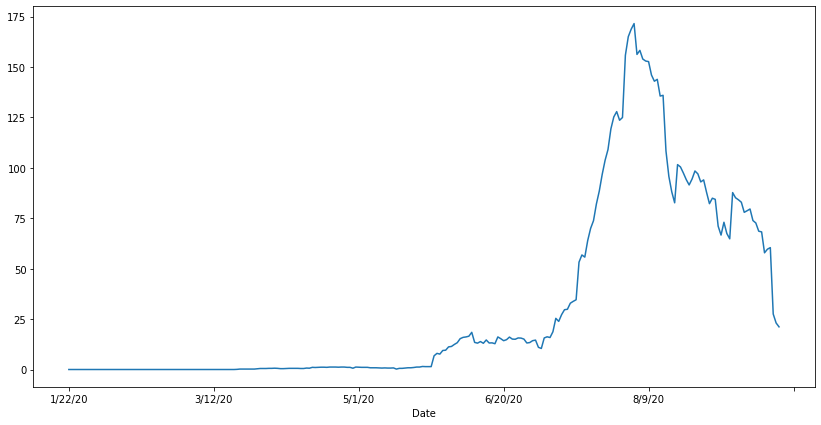

In [7]:
plt.figure(figsize=(14,7))
df_by_country_increase['Zimbabwe'].rolling(window=14).mean().fillna(0).plot(kind='line')

In [8]:
time_freq_jp = sum([[lst[0]]*int(lst[1]) for lst in list(enumerate(np.round(df_by_country_increase_rolling['Japan'].values, 0))) if lst[1]!=0], [])
len(time_freq_jp)

77228

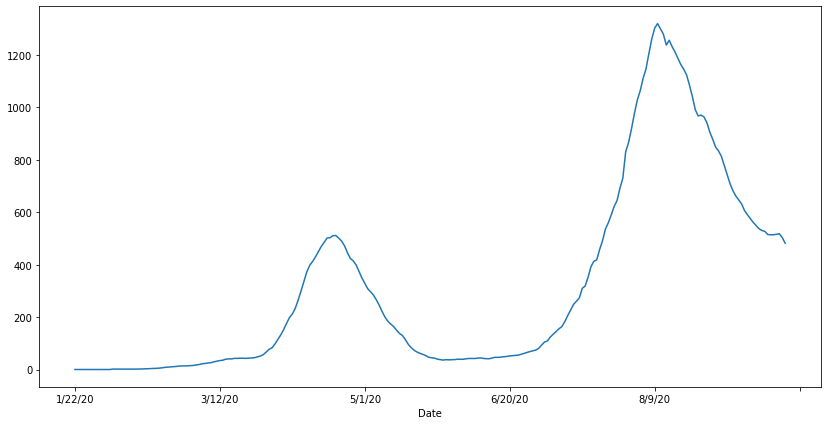

In [12]:
df_by_country_increase_rolling['Japan'].plot(kind='line',figsize=(14,7))

In [76]:
df_by_country_increase_rolling.reset_index()['Japan'][df_by_country_increase_rolling.reset_index()['Japan']>100]

70     114.785714
71     132.142857
72     152.285714
73     176.142857
74     198.000000
          ...    
241    513.928571
242    516.000000
243    517.785714
244    503.500000
245    481.785714
Name: Japan, Length: 129, dtype: float64

In [113]:
np.arange(70,130,15)

array([ 70,  85, 100, 115])

In [145]:
df_by_country_increase_rolling_scale = (df_by_country_increase_rolling-df_by_country_increase_rolling.min())/(df_by_country_increase_rolling.max()-df_by_country_increase_rolling.min())

In [177]:
sum([i[1] for i in list(enumerate(1000*np.round(df_by_country_increase_rolling_scale['US'].values, 3)))])

100032.0

In [180]:
list(enumerate(1000*np.round(df_by_country_increase_rolling_scale['US'].values, 3)))

[(0, 0.0),
 (1, 0.0),
 (2, 0.0),
 (3, 0.0),
 (4, 0.0),
 (5, 0.0),
 (6, 0.0),
 (7, 0.0),
 (8, 0.0),
 (9, 0.0),
 (10, 0.0),
 (11, 0.0),
 (12, 0.0),
 (13, 0.0),
 (14, 0.0),
 (15, 0.0),
 (16, 0.0),
 (17, 0.0),
 (18, 0.0),
 (19, 0.0),
 (20, 0.0),
 (21, 0.0),
 (22, 0.0),
 (23, 0.0),
 (24, 0.0),
 (25, 0.0),
 (26, 0.0),
 (27, 0.0),
 (28, 0.0),
 (29, 0.0),
 (30, 0.0),
 (31, 0.0),
 (32, 0.0),
 (33, 0.0),
 (34, 0.0),
 (35, 0.0),
 (36, 0.0),
 (37, 0.0),
 (38, 0.0),
 (39, 0.0),
 (40, 0.0),
 (41, 0.0),
 (42, 0.0),
 (43, 0.0),
 (44, 0.0),
 (45, 0.0),
 (46, 1.0),
 (47, 1.0),
 (48, 1.0),
 (49, 1.0),
 (50, 2.0),
 (51, 2.0),
 (52, 3.0),
 (53, 3.0),
 (54, 5.0),
 (55, 7.0),
 (56, 10.0),
 (57, 14.0),
 (58, 21.0),
 (59, 27.0),
 (60, 37.0),
 (61, 49.0),
 (62, 60.0),
 (63, 72.0),
 (64, 91.0),
 (65, 110.0),
 (66, 131.0),
 (67, 151.0),
 (68, 173.0),
 (69, 199.0),
 (70, 224.0),
 (71, 252.0),
 (72, 279.0),
 (73, 308.0),
 (74, 329.0),
 (75, 349.0),
 (76, 371.0),
 (77, 393.0),
 (78, 411.0),
 (79, 427.0),
 (80, 437.0

In [176]:
sum([i[1] for i in list(enumerate(np.round(df_by_country_increase_rolling['US'].values, 0)))])

6662774.0

In [157]:
sum(df_by_country_increase_rolling['Japan'])

77225.99999999997

In [189]:
pdf_actual

Date
1/22/20    NaN
1/23/20    NaN
1/24/20    NaN
1/25/20    NaN
1/26/20    NaN
          ... 
6/17/20    inf
6/18/20    inf
6/19/20    inf
6/20/20    inf
6/21/20    inf
Name: Japan, Length: 152, dtype: float64

In [191]:
df_by_country_increase_rolling_begin.sum()

13.180189445196213

In [243]:
df_by_country_increase_rolling_scale['Chile'].sum()

70.07666060054595

In [283]:
np.arange(0,100)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99])

In [355]:
for i in np.arange(35,260,7.5):
    df_by_country_increase_rolling_begin = df_by_country_increase_rolling_scale['Japan'].head(int(i))
    if df_by_country_increase_rolling_begin.sum() < 1:
        continue
    # full version - slow for US
#     print(i)
#     time_freq_jp = sum([[lst[0]]*int(lst[1]) for lst in list(enumerate(np.round(df_by_country_increase_rolling_begin.values, 0))) if lst[1]!=0], [])
    time_freq_jp = sum([[lst[0]]*int(lst[1]) for lst in list(enumerate(1000*np.round(df_by_country_increase_rolling_begin.values, 3))) if lst[1]!=0], [])
    time_freq_jp_res = Fit_Weibull_3P(failures=time_freq_jp,show_probability_plot=False,print_results=False)
    # plt.figure(figsize=(14,7))
    # plt.hist(time_freq_jp, bins=20)
    # time_freq_jp_res.distribution.PDF(xmin=0, xmax=260, show_plot=False)
    pdf_model = time_freq_jp_res.distribution.PDF(xvals=np.arange(int(i)), show_plot=False)
    # full version - slow for US
#     pdf_actual = df_by_country_increase_rolling_begin/np.round(df_by_country_increase_rolling_begin, 0).sum()
    pdf_actual = (df_by_country_increase_rolling_begin/df_by_country_increase_rolling_begin.sum()).head(int(i))
    # pdf_actual.plot(kind='line')
    print(int(i), np.sum(np.abs(pdf_actual[-30:-15]-pdf_model[-30:-15])**2), np.sum(np.abs(pdf_actual[-15:]-pdf_model[-15:])**2), np.sum(np.abs(pdf_actual-pdf_model))**2)
    # plt.show()

72 0.00032519074032635507 0.008608452377142941 0.13275074238456866
80 0.0014648843752564978 0.0132534582402798 0.2698369335378128
87 0.0013691482880072627 0.007666181641019191 0.20875245616681756
95 0.0006489560204762792 0.0022952569485785597 0.08895713131090206
102 0.00012821934834427546 0.0005735472139521828 0.034549767107495154
110 5.270977425131186e-05 0.00012661502713744922 0.01941778816961071
117 0.0001248399033990772 5.220093423396122e-05 0.026193627912828858
125 9.920269505277483e-05 1.7178993848318716e-05 0.036252995761027515
132 0.00013575720136961252 2.1718667829253938e-05 0.05405490976631482
140 0.00015405501433998685 3.4359083639295414e-05 0.08949425207408979
147 0.00014511932537924374 4.703846162731956e-05 0.1309858902717675
155 7.733739136551363e-05 6.845497118295019e-05 0.1914883001184752
162 3.924254520559185e-05 0.00011741222943791363 0.263438754102123
170 4.25657273315799e-05 0.0003536545416792424 0.381317175764918
177 5.6065528625120944e-05 0.000952773914176934 0.49

ValueError: operands could not be broadcast together with shapes (246,) (252,) 

110 8.441001809163282e-06


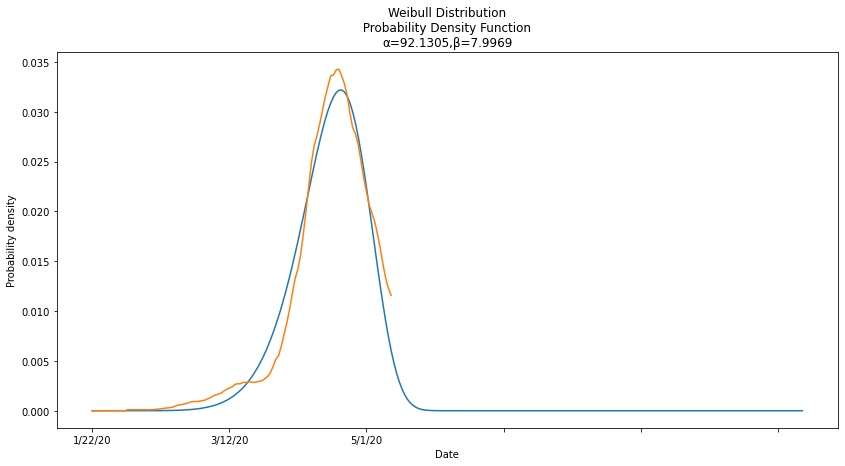

In [361]:
i = 110
df_by_country_increase_rolling_begin = df_by_country_increase_rolling_scale['Japan'].head(i)
# full version - slow for US
#     time_freq_jp = sum([[lst[0]]*int(lst[1]) for lst in list(enumerate(np.round(df_by_country_increase_rolling_begin.values, 0))) if lst[1]!=0], [])
time_freq_jp = sum([[lst[0]]*int(lst[1]) for lst in list(enumerate(1000*np.round(df_by_country_increase_rolling_begin.values, 3))) if lst[1]!=0], [])
time_freq_jp_res = Fit_Weibull_3P(failures=time_freq_jp,show_probability_plot=False,print_results=False)
plt.figure(figsize=(14,7))
# plt.hist(time_freq_jp, bins=20)
time_freq_jp_res.distribution.PDF(xvals=np.arange(int(260)))
pdf_model = time_freq_jp_res.distribution.PDF(xvals=np.arange(int(i)), show_plot=False)
# full version - slow for US
#     pdf_actual = df_by_country_increase_rolling_begin/np.round(df_by_country_increase_rolling_begin, 0).sum()
pdf_actual = df_by_country_increase_rolling_begin/df_by_country_increase_rolling_begin.sum()
pdf_actual.plot(kind='line')
print(int(i), np.mean((pdf_actual[-15:]-pdf_model[-15:])**2))

In [334]:
pdf_actual-pdf_model

Date
1/22/20    0.000000e+00
1/23/20   -9.293286e-11
1/24/20   -1.742986e-09
1/25/20   -9.683313e-09
1/26/20   -3.269026e-08
               ...     
6/12/20    5.665138e-03
6/13/20    6.131967e-03
6/14/20    6.536651e-03
6/15/20    6.990755e-03
6/16/20    7.439403e-03
Name: US, Length: 147, dtype: float64

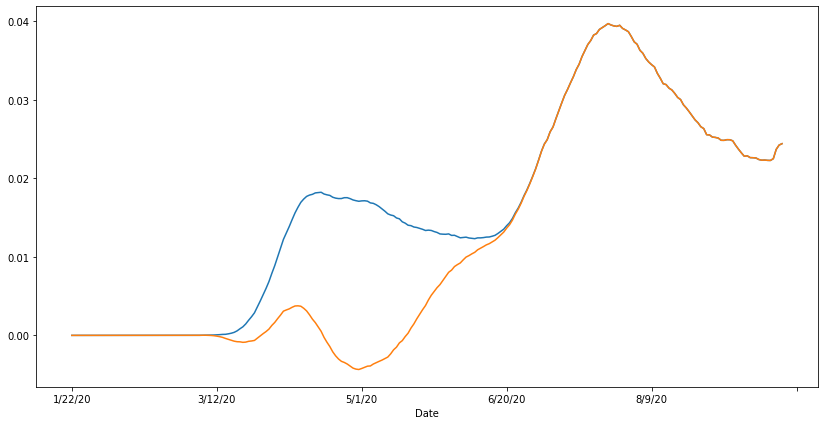

In [354]:
plt.figure(figsize=(14,7))
(df_by_country_increase_rolling_scale['US']/df_by_country_increase_rolling_scale['US'].head(i).sum()).plot(kind='line')
# np.clip(pdf_actual-pdf_model, 0, None).plot(kind='line')
# (pdf_actual-pdf_model).plot(kind='line')
# pdf_actual.plot(kind='line')
(df_by_country_increase_rolling_scale['US']/df_by_country_increase_rolling_scale['US'].head(i).sum() - time_freq_jp_res.distribution.PDF(xvals=np.arange(len(df_by_country_increase_rolling_scale)), show_plot=False)).plot(kind='line')

array([0.00000000e+00, 1.95363364e-16, 4.99059920e-14, 1.27743414e-12,
       1.27485931e-11, 7.59351480e-11, 3.26323301e-10, 1.11947781e-09,
       3.25665556e-09, 8.35283512e-09, 1.93977969e-08, 4.15686530e-08,
       8.33599865e-08, 1.58105519e-07, 2.85972976e-07, 4.96521580e-07,
       8.31919332e-07, 1.35092500e-06, 2.13374745e-06, 3.28790271e-06,
       4.95519676e-06, 7.31996986e-06, 1.06187458e-05, 1.51514366e-05,
       2.12942622e-05, 2.95145492e-05, 4.03875829e-05, 5.46156924e-05,
       7.30497548e-05, 9.67133115e-05, 1.26829495e-04, 1.64850969e-04,
       2.12493093e-04, 2.71770512e-04, 3.45037394e-04, 4.35031521e-04,
       5.44922439e-04, 6.78363871e-04, 8.39550589e-04, 1.03327991e-03,
       1.26501801e-03, 1.54097110e-03, 1.86816172e-03, 2.25451000e-03,
       2.70892011e-03, 3.24137160e-03, 3.86301572e-03, 4.58627623e-03,
       5.42495456e-03, 6.39433857e-03, 7.51131443e-03, 8.79448055e-03,
       1.02642626e-02, 1.19430279e-02, 1.38551981e-02, 1.60273572e-02,
      

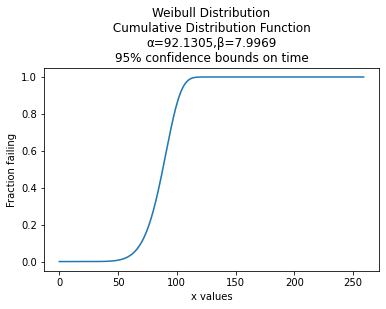

In [309]:
time_freq_jp_res.distribution.CDF(xvals=np.arange(int(260)))

Results from Fit_Weibull_2P (95% CI):
           Point Estimate  Standard Error   Lower CI   Upper CI
Parameter                                                      
Alpha           94.786044        0.113114  94.564605  95.008003
Beta             6.934819        0.042485   6.852047   7.018591
Log-Likelihood: -66328.5224427453 

4.690367086354647e-05


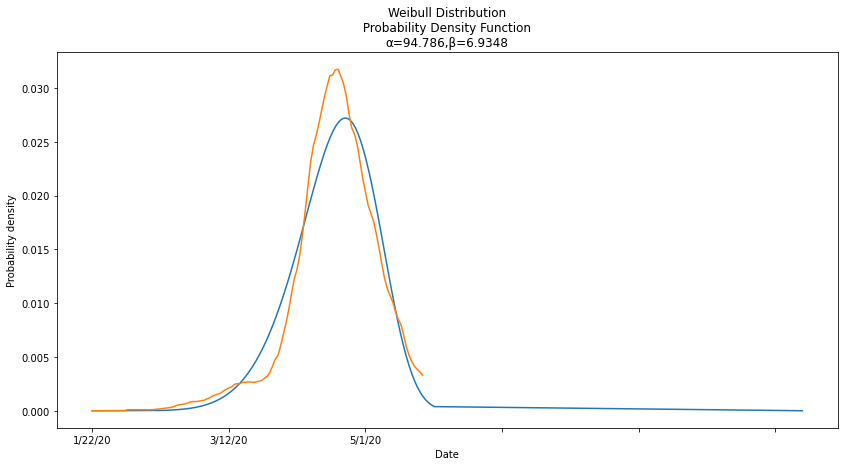

In [131]:
# df_by_country_increase_rolling_begin = df_by_country_increase_rolling['Japan'].head(122)
# time_freq_jp = sum([[lst[0]]*int(lst[1]) for lst in list(enumerate(np.round(df_by_country_increase_rolling_begin.values, 0))) if lst[1]!=0], [])
# len(time_freq_jp)
# time_freq_jp_res = Fit_Weibull_2P(failures=time_freq_jp,show_probability_plot=False)
# plt.figure(figsize=(14,7))
# # plt.hist(time_freq_jp, bins=20)
# time_freq_jp_res.distribution.PDF(xmin=0, xmax=260)
# pdf_model = time_freq_jp_res.distribution.PDF(xvals=122, show_plot=False)
# pdf_actual = df_by_country_increase_rolling_begin/np.round(df_by_country_increase_rolling_begin, 0).sum()
# pdf_actual.plot(kind='line')
# print(np.mean((pdf_actual[-15:]-pdf_model[-15:])**2))
# plt.show()

Results from Fit_Weibull_Mixture (95% CI):
              Point Estimate  Standard Error    Lower CI    Upper CI
Parameter                                                           
Alpha 1            95.366655        0.128141   95.115833   95.618137
Beta 1              6.579434        0.045813    6.490253    6.669841
Alpha 2           212.128131        0.075710  211.979794  212.276571
Beta 2             12.466357        0.042583   12.383175   12.550098
Proportion 1        0.220867        0.001542    0.217859    0.223904
Log-Likelihood: -356564.40143338736 



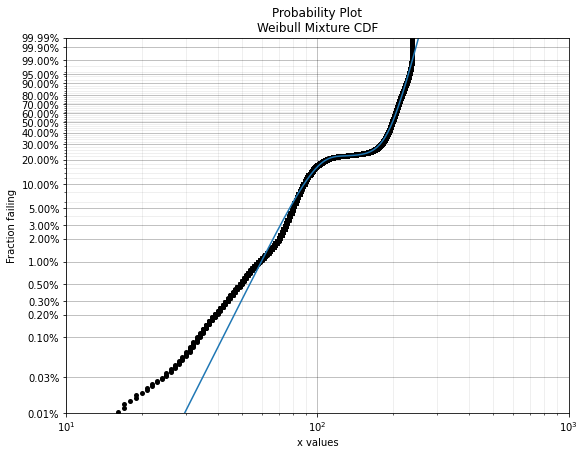

In [19]:
# from reliability.Fitters import Fit_Weibull_Mixture
time_freq_jp_res = Fit_Weibull_Mixture(failures=time_freq_jp)

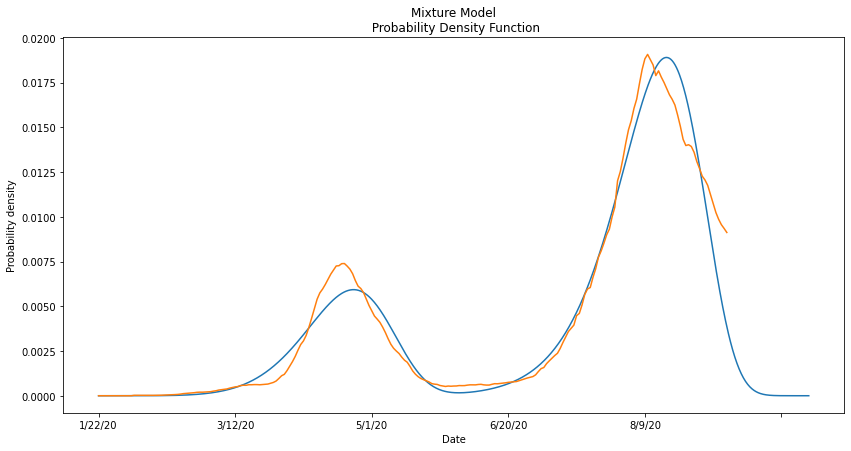

In [43]:
plt.figure(figsize=(14,7))
# plt.hist(time_freq_jp, bins=20)
time_freq_jp_res.distribution.PDF(xmin=0, xmax=260)
(df_by_country_increase['Japan'].rolling(window=14).mean().fillna(0)/np.round(df_by_country_increase['Japan'].rolling(window=14).mean().fillna(0), 0).sum()).plot(kind='line')
plt.show()

(1000,)

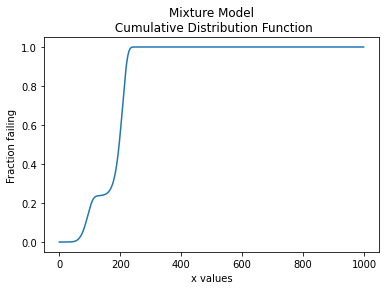

In [69]:
time_freq_jp_res.distribution.CDF(xmin=0, xmax=999).shape

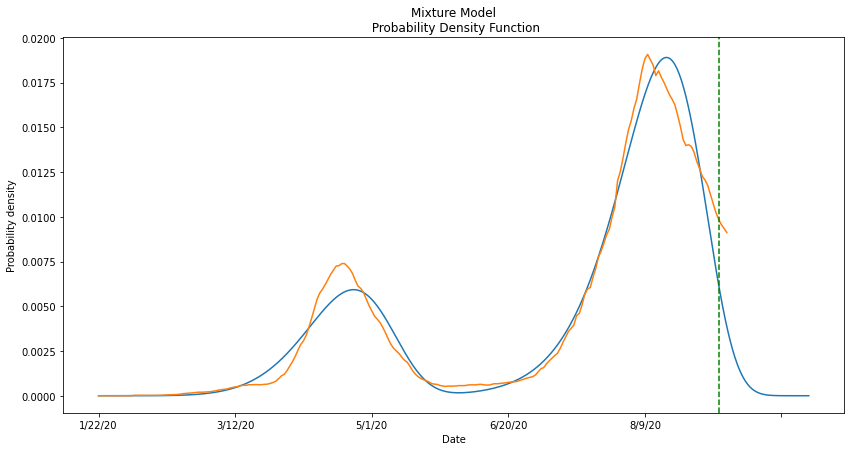

In [71]:
plt.figure(figsize=(14,7))
# plt.hist(time_freq_jp, bins=20)
time_freq_jp_res.distribution.PDF(xmin=0, xmax=260)
(df_by_country_increase['Japan'].rolling(window=14).mean().fillna(0)/np.round(df_by_country_increase['Japan'].rolling(window=14).mean().fillna(0), 0).sum()).plot(kind='line')
plt.axvline(x=227, color='g',linestyle='--')
plt.show()

227

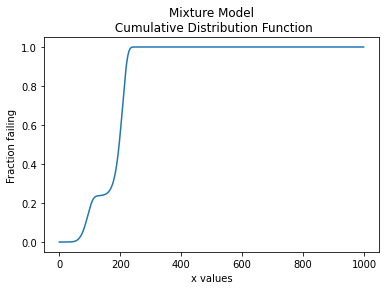

In [70]:
time_freq_jp_res_cdf = time_freq_jp_res.distribution.CDF(xmin=0, xmax=999)
np.abs(time_freq_jp_res_cdf-0.97).argmin()

In [75]:
from datetime import date, timedelta
date(2020,1,22)+timedelta(days=227)

datetime.date(2020, 9, 5)

In [86]:
(date(2020,1,22)+timedelta(days=227)).strftime('%Y/%m/%d')

'2020/09/05'

In [ ]:
(date(2020,1,22)+timedelta(days=227)).strftime

array([0.00000000e+00, 0.00000000e+00, 9.01717725e-16, 1.75834956e-14,
       1.01894103e-13, 3.91796351e-13, 1.16141243e-12, 2.87918470e-12,
       6.27956224e-12, 1.24360400e-11, 2.28423134e-11, 3.94947855e-11,
       6.49867964e-11, 1.02604656e-10, 1.56424581e-10, 2.31421346e-10,
       3.33572438e-10, 4.69977082e-10, 6.48968501e-10, 8.80235653e-10,
       1.17494766e-09, 1.54588278e-09, 2.00755729e-09, 2.57636309e-09,
       3.27070287e-09, 4.11113264e-09, 5.12050509e-09, 6.32411836e-09,
       7.74986438e-09, 9.42838398e-09, 1.13932201e-08, 1.36809803e-08,
       1.63314957e-08, 1.93879852e-08, 2.28972249e-08, 2.69097145e-08,
       3.14798526e-08, 3.66661096e-08, 4.25312036e-08, 4.91422851e-08,
       5.65711136e-08, 6.48942437e-08, 7.41932158e-08, 8.45547392e-08,
       9.60708892e-08, 1.08839296e-07, 1.22963348e-07, 1.38552378e-07,
       1.55721879e-07, 1.74593692e-07, 1.95296226e-07, 2.17964648e-07,
       2.42741107e-07, 2.69774937e-07, 2.99222871e-07, 3.31249261e-07,
      

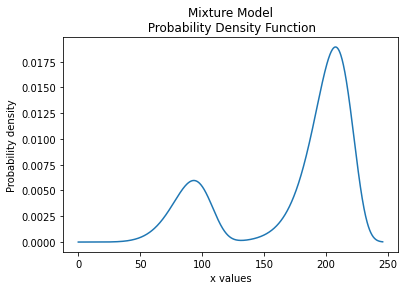

In [31]:
time_freq_jp_res.distribution.PDF(xmin=0, xmax=246)

(1000,)

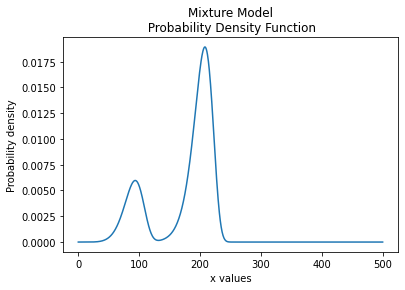

In [24]:
time_freq_jp_res.distribution.PDF(xmin=0, xmax=500).shape

Results from Fit_Weibull_Mixture (95% CI):
              Point Estimate  Standard Error    Lower CI    Upper CI
Parameter                                                           
Alpha 1           107.771715        0.030746  107.711472  107.831992
Beta 1              5.558939        0.004881    5.549381    5.568514
Alpha 2           197.831382        0.014490  197.802985  197.859783
Beta 2              8.564744        0.004835    8.555274    8.574225
Proportion 1        0.270012        0.000247    0.269528    0.270497
Log-Likelihood: -30962403.353478625 



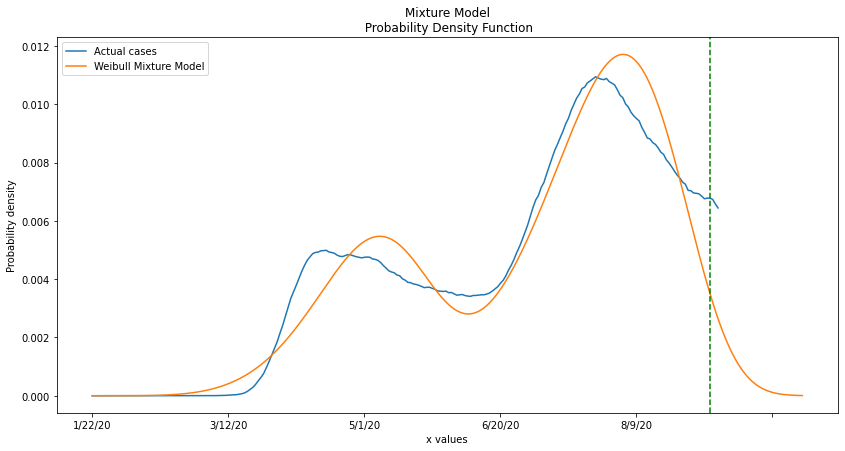

In [103]:
from reliability.Fitters import Fit_Weibull_Mixture
time_freq_jp = sum([[lst[0]]*int(lst[1]) for lst in list(enumerate(np.round(df_by_country_increase['US'].rolling(window=14).mean().fillna(0).values, 0))) if lst[1]!=0], [])
time_freq_jp_res = Fit_Weibull_Mixture(failures=time_freq_jp, show_probability_plot=False)

plt.figure(figsize=(14,7))
# plt.hist(time_freq_jp, bins=20)
(df_by_country_increase['US'].rolling(window=14).mean().fillna(0)/np.round(df_by_country_increase['US'].rolling(window=14).mean().fillna(0), 0).sum()).plot(kind='line')
time_freq_jp_res.distribution.PDF(xmin=0, xmax=df_by_country_increase.shape[0]+30)

time_freq_jp_res_cdf = time_freq_jp_res.distribution.CDF(xmin=0, xmax=999, show_plot=False) # always return array of length 1000
cdf_thresh = 0.97 # predict 97% of cases
cdf_thresh_day = np.abs(time_freq_jp_res_cdf-cdf_thresh).argmin()
plt.axvline(x=cdf_thresh_day, color='g',linestyle='--')
# plt.text(0.5, 0.9, '97% of cases ends at '+(date(2020,1,22)+timedelta(days=227)).strftime('%Y/%m/%d'))
plt.legend(['Actual cases','Weibull Mixture Model'])
plt.show()

Results from Fit_Weibull_Mixture (95% CI):
              Point Estimate  Standard Error    Lower CI    Upper CI
Parameter                                                           
Alpha 1            95.709671        0.131733   95.451827   95.968211
Beta 1              6.430077        0.045476    6.341561    6.519828
Alpha 2           208.865848        0.068982  208.730690  209.001094
Beta 2             14.023806        0.050878   13.924440   14.123881
Proportion 1        0.236740        0.001629    0.233562    0.239948
Log-Likelihood: -330324.9653867354 



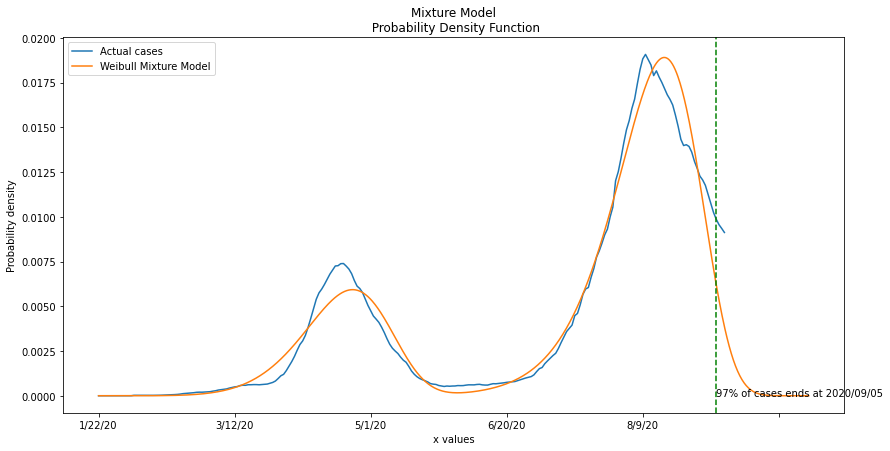

In [119]:
from reliability.Fitters import Fit_Weibull_Mixture
time_freq_jp = sum([[lst[0]]*int(lst[1]) for lst in list(enumerate(np.round(df_by_country_increase['Japan'].rolling(window=14).mean().fillna(0).values, 0))) if lst[1]!=0], [])
time_freq_jp_res = Fit_Weibull_Mixture(failures=time_freq_jp, show_probability_plot=False)

plt.figure(figsize=(14,7))
# plt.hist(time_freq_jp, bins=20)
(df_by_country_increase['Japan'].rolling(window=14).mean().fillna(0)/np.round(df_by_country_increase['Japan'].rolling(window=14).mean().fillna(0), 0).sum()).plot(kind='line')
time_freq_jp_res.distribution.PDF(xmin=0, xmax=df_by_country_increase.shape[0]+30)

time_freq_jp_res_cdf = time_freq_jp_res.distribution.CDF(xmin=0, xmax=999, show_plot=False) # always return array of length 1000
cdf_thresh = 0.97 # predict 97% of cases
cdf_thresh_day = np.abs(time_freq_jp_res_cdf-cdf_thresh).argmin()
plt.axvline(x=cdf_thresh_day, color='g',linestyle='--')
plt.text(cdf_thresh_day, 0, '97% of cases ends at '+(date(2020,1,22)+timedelta(days=227)).strftime('%Y/%m/%d'))
plt.title('2 Weibull Mixture Model in Japan')
plt.legend(['Actual cases','Weibull Mixture Model'])
plt.show()

Results from Fit_Weibull_Mixture (95% CI):
              Point Estimate  Standard Error    Lower CI    Upper CI
Parameter                                                           
Alpha 1           148.242580        0.646456  146.980949  149.515040
Beta 1              7.198643        0.037523    7.125475    7.272563
Alpha 2           189.368383        3.920242  181.838640  197.209924
Beta 2              7.094101        0.679727    5.879478    8.559650
Proportion 1        0.608478        0.056108    0.494829    0.711468
Log-Likelihood: -49169.53368512918 



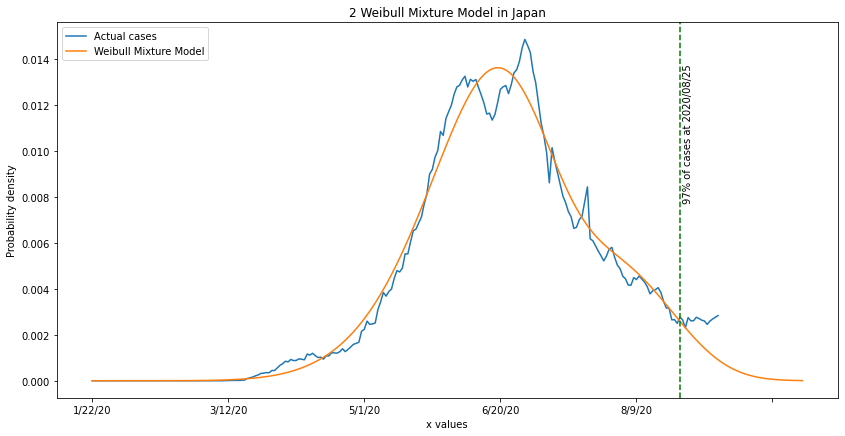

In [201]:
from reliability.Fitters import Fit_Weibull_Mixture
time_freq_jp = sum([[lst[0]]*int(lst[1]) for lst in list(enumerate(np.round(df_by_country_increase['Congo (Kinshasa)'].rolling(window=14).mean().fillna(0).values, 0))) if lst[1]!=0], [])
time_freq_jp_res = Fit_Weibull_Mixture(failures=time_freq_jp, show_probability_plot=False)

fig = plt.figure(figsize=(14,7))
# plt.hist(time_freq_jp, bins=20)
(df_by_country_increase['Congo (Kinshasa)'].rolling(window=14).mean().fillna(0)/np.round(df_by_country_increase['Congo (Kinshasa)'].rolling(window=14).mean().fillna(0), 0).sum()).plot(kind='line')
time_freq_jp_res.distribution.PDF(xmin=0, xmax=df_by_country_increase.shape[0]+30)

time_freq_jp_res_cdf = time_freq_jp_res.distribution.CDF(xmin=0, xmax=999, show_plot=False) # always return array of length 1000
cdf_thresh = 0.97 # predict 97% of cases
cdf_thresh_day = np.abs(time_freq_jp_res_cdf-cdf_thresh).argmin()
plt.axvline(x=cdf_thresh_day, color='g',linestyle='--')
plt.text(cdf_thresh_day+1, plt.ylim()[1]*0.5, '97% of cases at '+(date(2020,1,22)+timedelta(days=int(cdf_thresh_day))).strftime('%Y/%m/%d'), rotation=90)
plt.title('2 Weibull Mixture Model in Japan')
plt.legend(['Actual cases','Weibull Mixture Model'], loc='upper left')
plt.show()

In [198]:
# loc, shape, ???, scale
exponweib.fit(time_freq_jp, 1, 1)

(179.23266220011783,
 1.6109767811891929,
 -136.68558115661915,
 99.03960080619697)

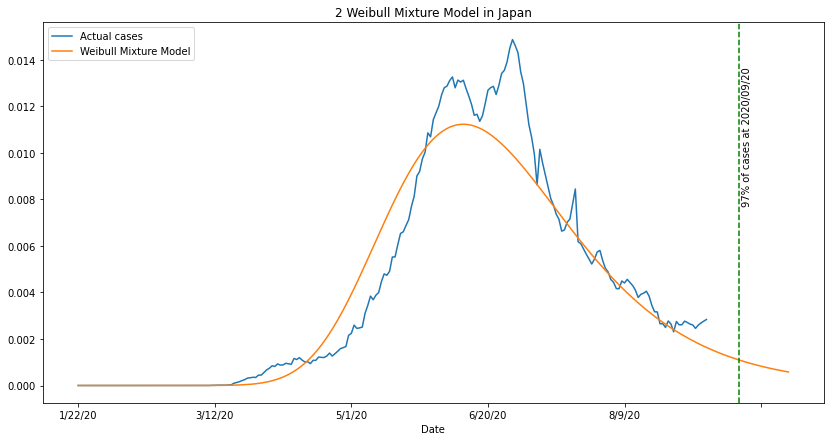

In [202]:
from scipy.stats import weibull_min, exponweib
time_freq_jp = sum([[lst[0]]*int(lst[1]) for lst in list(enumerate(np.round(df_by_country_increase['Congo (Kinshasa)'].rolling(window=14).mean().fillna(0).values, 0))) if lst[1]!=0], [])
fig = plt.figure(figsize=(14,7))
(df_by_country_increase['Congo (Kinshasa)'].rolling(window=14).mean().fillna(0)/np.round(df_by_country_increase['Congo (Kinshasa)'].rolling(window=14).mean().fillna(0), 0).sum()).plot(kind='line')
x = np.linspace(0,df_by_country_increase.shape[0]-1+30,df_by_country_increase.shape[0]+30)
weibull_params = exponweib.fit(time_freq_jp, 1, 1)
plt.plot(x, exponweib.pdf(x, *weibull_params))
weibull_cdf = exponweib.cdf(x, *weibull_params)
cdf_thresh = 0.97 # predict 97% of cases
cdf_thresh_day = np.abs(weibull_cdf-cdf_thresh).argmin()
plt.axvline(x=cdf_thresh_day, color='g',linestyle='--')
plt.text(cdf_thresh_day+1, plt.ylim()[1]*0.5, '97% of cases at '+(date(2020,1,22)+timedelta(days=int(cdf_thresh_day))).strftime('%Y/%m/%d'), rotation=90)
plt.title('2 Weibull Mixture Model in Japan')
plt.legend(['Actual cases','Weibull Mixture Model'], loc='upper left')
plt.show()

Results from Fit_Weibull_Mixture (95% CI):
              Point Estimate  Standard Error    Lower CI    Upper CI
Parameter                                                           
Alpha 1            86.614796        0.279883   86.067969   87.165097
Beta 1              5.958445        0.089305    5.785956    6.136075
Alpha 2           205.456869        0.223056  205.020152  205.894517
Beta 2              8.324867        0.075942    8.177346    8.475050
Proportion 1        0.310331        0.003234    0.304029    0.316704
Log-Likelihood: -133135.64046841962 



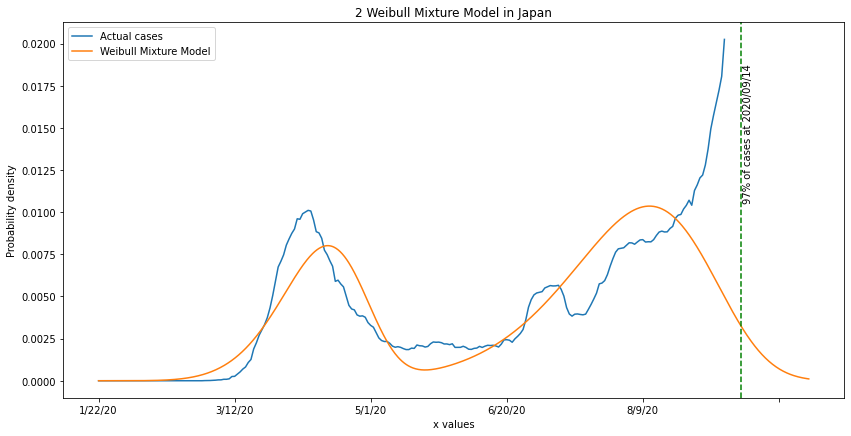

In [205]:
from reliability.Fitters import Fit_Weibull_Mixture
time_freq_jp = sum([[lst[0]]*int(lst[1]) for lst in list(enumerate(np.round(df_by_country_increase['Czechia'].rolling(window=14).mean().fillna(0).values, 0))) if lst[1]!=0], [])
time_freq_jp_res = Fit_Weibull_Mixture(failures=time_freq_jp, show_probability_plot=False)

fig = plt.figure(figsize=(14,7))
# plt.hist(time_freq_jp, bins=20)
(df_by_country_increase['Czechia'].rolling(window=14).mean().fillna(0)/np.round(df_by_country_increase['Czechia'].rolling(window=14).mean().fillna(0), 0).sum()).plot(kind='line')
time_freq_jp_res.distribution.PDF(xmin=0, xmax=df_by_country_increase.shape[0]+30)

time_freq_jp_res_cdf = time_freq_jp_res.distribution.CDF(xmin=0, xmax=999, show_plot=False) # always return array of length 1000
cdf_thresh = 0.97 # predict 97% of cases
cdf_thresh_day = np.abs(time_freq_jp_res_cdf-cdf_thresh).argmin()
plt.axvline(x=cdf_thresh_day, color='g',linestyle='--')
plt.text(cdf_thresh_day+1, plt.ylim()[1]*0.5, '97% of cases at '+(date(2020,1,22)+timedelta(days=int(cdf_thresh_day))).strftime('%Y/%m/%d'), rotation=90)
plt.title('2 Weibull Mixture Model')
plt.legend(['Actual cases','Weibull Mixture Model'], loc='upper left')
plt.show()

In [156]:
weibull_min.fit?

In [208]:
df_country_peaks.loc['US']

country                                                             US
peaks_index                                                  [86, 185]
incr_ratio_2w_now                                             0.719859
peaks_date                                          [4/17/20, 7/25/20]
peaks_case                     [30389.214285714286, 66646.07142857143]
peaks_case_zip       [(86, 4/17/20, 30389.214285714286), (185, 7/25...
current_growth       [(86, 4/17/20, 30389.214285714286), (185, 7/25...
peaks_case_filter    [(86, 4/17/20, 30389.214285714286), (185, 7/25...
trend                                            Constant/Inconclusive
no_peaks                                                             2
Name: US, dtype: object

Results from Fit_Weibull_Mixture (95% CI):
              Point Estimate  Standard Error    Lower CI    Upper CI
Parameter                                                           
Alpha 1            86.614796        0.279883   86.067969   87.165097
Beta 1              5.958445        0.089305    5.785956    6.136075
Alpha 2           205.456869        0.223056  205.020152  205.894517
Beta 2              8.324867        0.075942    8.177346    8.475050
Proportion 1        0.310331        0.003234    0.304029    0.316704
Log-Likelihood: -133135.64046841962 



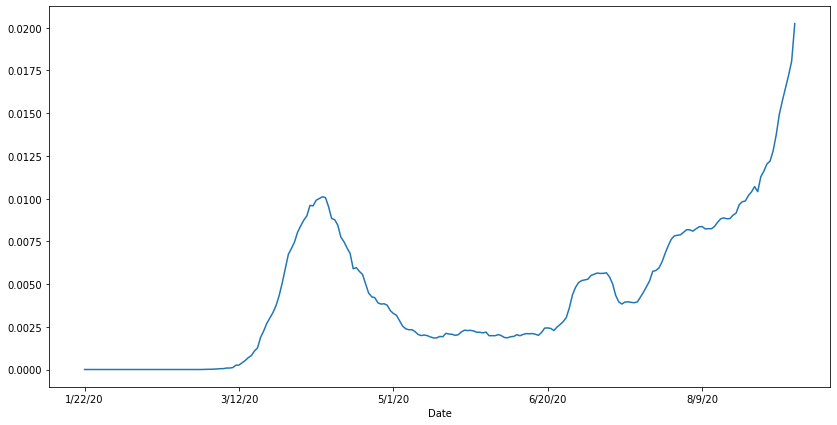

In [25]:
from reliability.Fitters import Fit_Weibull_Mixture
time_freq_jp = sum([[lst[0]]*int(lst[1]) for lst in list(enumerate(np.round(df_by_country_increase['Czechia'].rolling(window=14).mean().fillna(0).values, 0))) if lst[1]!=0], [])
time_freq_jp_res = Fit_Weibull_Mixture(failures=time_freq_jp, show_probability_plot=False)

fig = plt.figure(figsize=(14,7))
# plt.hist(time_freq_jp, bins=20)
(df_by_country_increase['Czechia'].rolling(window=14).mean().fillna(0)/np.round(df_by_country_increase['Czechia'].rolling(window=14).mean().fillna(0), 0).sum()).plot(kind='line')
time_freq_jp_res.distribution.PDF?
#(xmin=0, xmax=df_by_country_increase.shape[0]+30)

# time_freq_jp_res_cdf = time_freq_jp_res.distribution.CDF(xmin=0, xmax=999, show_plot=False) # always return array of length 1000
# cdf_thresh = 0.97 # predict 97% of cases
# cdf_thresh_day = np.abs(time_freq_jp_res_cdf-cdf_thresh).argmin()
# plt.axvline(x=cdf_thresh_day, color='g',linestyle='--')
# plt.text(cdf_thresh_day+1, plt.ylim()[1]*0.5, '97% of cases at '+(date(2020,1,22)+timedelta(days=int(cdf_thresh_day))).strftime('%Y/%m/%d'), rotation=90)
# plt.title('2 Weibull Mixture Model')
# plt.legend(['Actual cases','Weibull Mixture Model'], loc='upper left')
# plt.show()

In [205]:
Fit_Weibull_2P(failures=time_freq, show_probability_plot=False, print_results=False).gamma

0

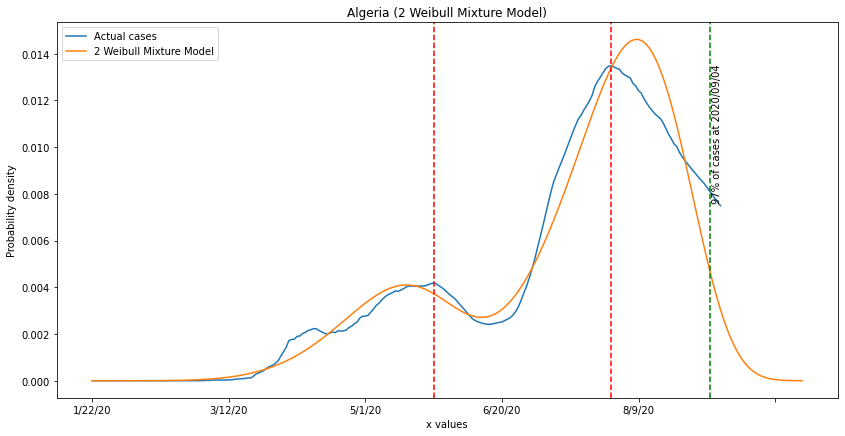

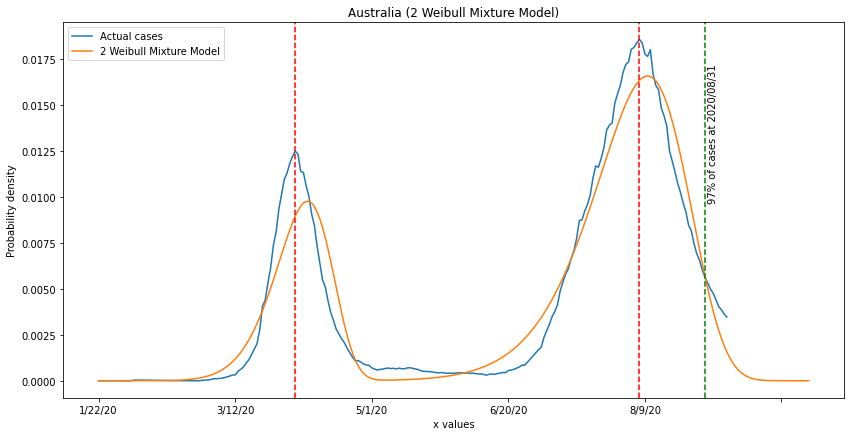

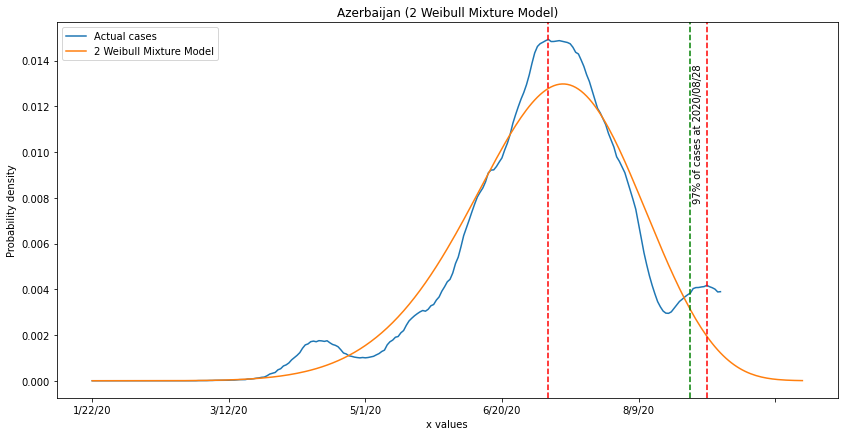

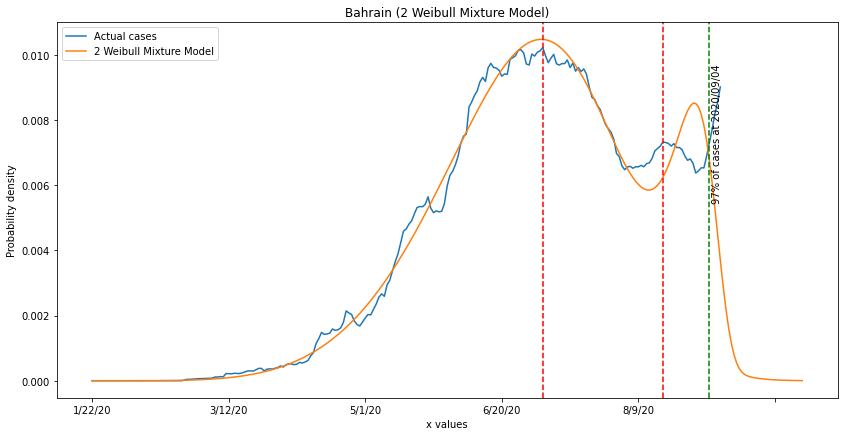

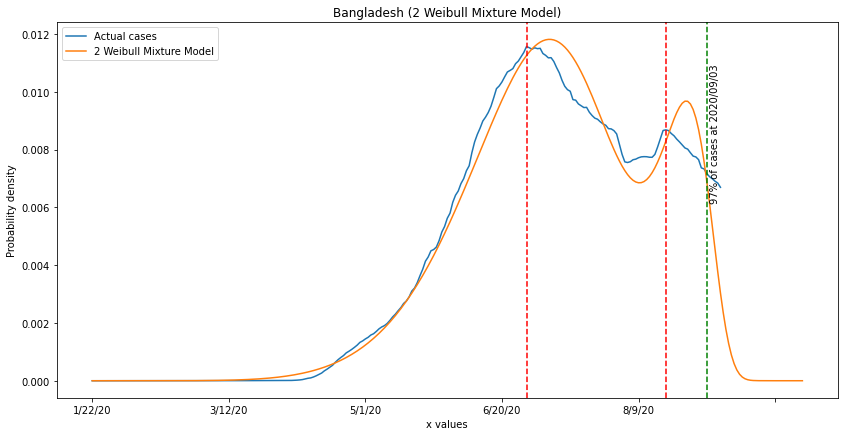

...

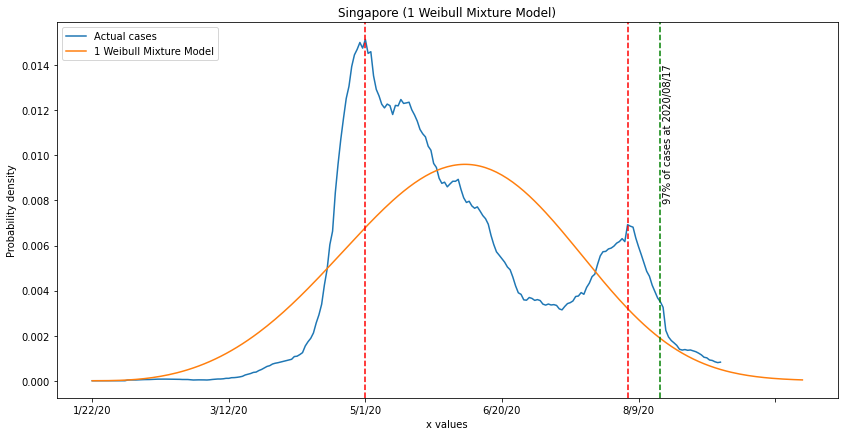

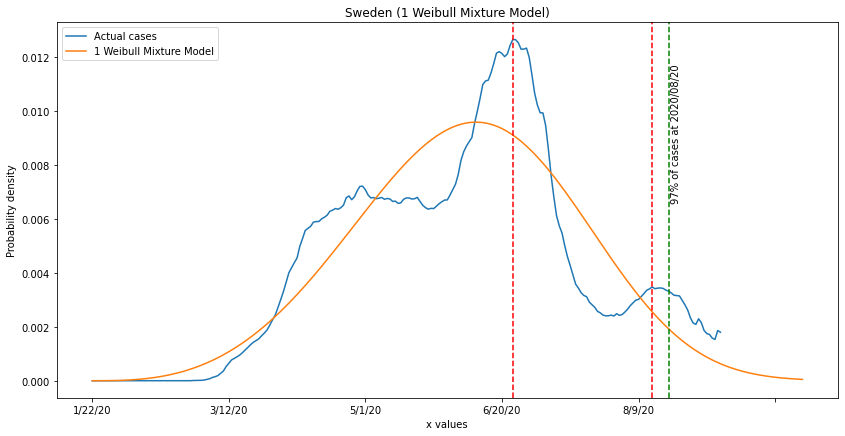

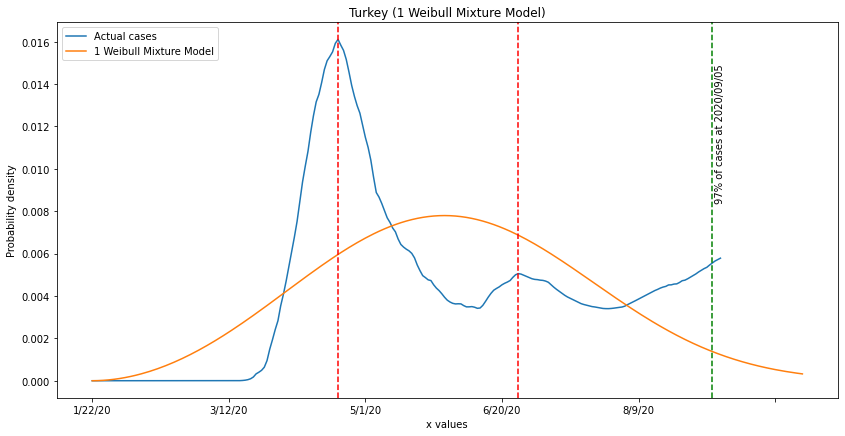

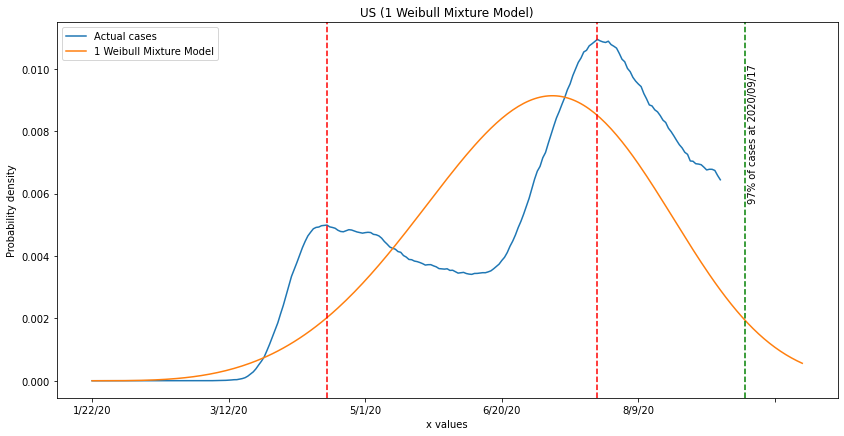

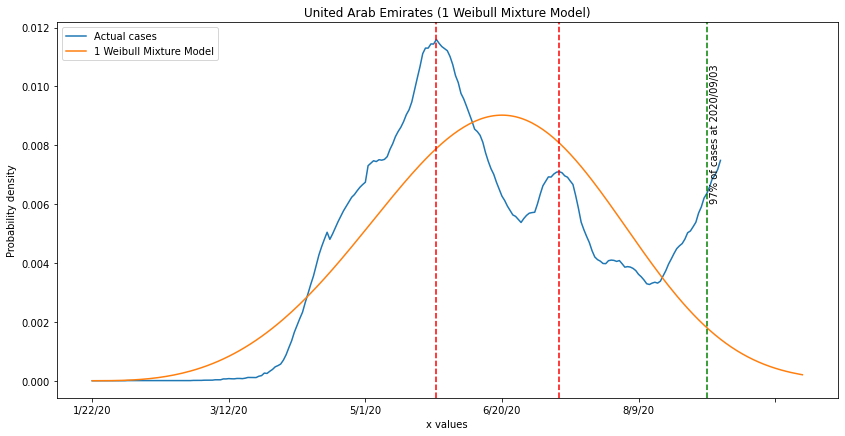

In [212]:
df_country_prob_2w = pd.DataFrame({'country':[],'actual':[],'2_weibull':[],'2w_params':[],'97p_case_2w':[]})
df_country_prob_1w = pd.DataFrame({'country':[],'actual':[],'1_weibull':[],'1w_params':[],'97p_case_1w':[]})
x = np.linspace(0,df_by_country_increase.shape[0]-1+30,df_by_country_increase.shape[0]+30)
for country in df_country_peaks[(df_country_peaks['no_peaks']==2) & (df_country_peaks['trend']!='Increasing')].index:
    plt.figure(figsize=(14,7))
    time_freq = sum([[lst[0]]*int(lst[1]) for lst in list(enumerate(np.round(df_by_country_increase[country].rolling(window=14).mean().fillna(0).values, 0))) if lst[1]!=0], [])
    time_freq_res = Fit_Weibull_Mixture(failures=time_freq, show_probability_plot=False, print_results=False)

    country_prob_dist = (df_by_country_increase[country].rolling(window=14).mean().fillna(0)/np.round(df_by_country_increase[country].rolling(window=14).mean().fillna(0), 0).sum())
    country_prob_dist.plot(kind='line')
    time_freq_res.distribution.PDF(xvals=x)

    time_freq_res_cdf = time_freq_res.distribution.CDF(xvals=x, show_plot=False) # always return array of length 1000
    cdf_thresh = 0.97 # predict 97% of cases
    cdf_thresh_day = np.abs(time_freq_res_cdf-cdf_thresh).argmin()
    plt.axvline(x=cdf_thresh_day, color='g',linestyle='--')
    plt.text(cdf_thresh_day+1, plt.ylim()[1]*0.5, '97% of cases at '+(date(2020,1,22)+timedelta(days=int(cdf_thresh_day))).strftime('%Y/%m/%d'), rotation=90)
    plt.title(country+' (2 Weibull Mixture Model)')
    plt.legend(['Actual cases','2 Weibull Mixture Model'], loc='upper left')
    
    for peak in df_country_peaks.loc[[country]]['peaks_case_filter'].values[0]:
        plt.axvline(x=peak[0],color='r',linestyle='--')
    plt.savefig('./output-2weibull/'+country+'.jpg')
    df_country_prob_2w = df_country_prob_2w.append(
        {'country':country,
         'actual':country_prob_dist.values,
         '2_weibull':time_freq_res.distribution.PDF(xvals=x, show_plot=False, plot_components=False),
         '2w_params':(
             time_freq_res.alpha_1, time_freq_res.beta_1, time_freq_res.proportion_1,
             time_freq_res.alpha_2, time_freq_res.beta_2, time_freq_res.proportion_2,
         ),
         '97p_case_2w':date(2020,1,22)+timedelta(days=int(cdf_thresh_day))
        },
        ignore_index=True)

# plt.figure(figsize=(14,7))
for country in df_country_peaks[(df_country_peaks['no_peaks']==2) & (df_country_peaks['trend']!='Increasing')].index:
    plt.figure(figsize=(14,7))
    time_freq = sum([[lst[0]]*int(lst[1]) for lst in list(enumerate(np.round(df_by_country_increase[country].rolling(window=14).mean().fillna(0).values, 0))) if lst[1]!=0], [])
    time_freq_res = Fit_Weibull_2P(failures=time_freq, show_probability_plot=False, print_results=False)

    country_prob_dist = (df_by_country_increase[country].rolling(window=14).mean().fillna(0)/np.round(df_by_country_increase[country].rolling(window=14).mean().fillna(0), 0).sum())
    country_prob_dist.plot(kind='line')
    time_freq_res.distribution.PDF(xvals=x)

    time_freq_res_cdf = time_freq_res.distribution.CDF(xvals=x, show_plot=False) # always return array of length 1000
    cdf_thresh = 0.97 # predict 97% of cases
    cdf_thresh_day = np.abs(time_freq_res_cdf-cdf_thresh).argmin()
    plt.axvline(x=cdf_thresh_day, color='g',linestyle='--')
    plt.text(cdf_thresh_day+1, plt.ylim()[1]*0.5, '97% of cases at '+(date(2020,1,22)+timedelta(days=int(cdf_thresh_day))).strftime('%Y/%m/%d'), rotation=90)
    plt.title(country+' (1 Weibull Mixture Model)')
    plt.legend(['Actual cases','1 Weibull Mixture Model'], loc='upper left')
    
    for peak in df_country_peaks.loc[[country]]['peaks_case_filter'].values[0]:
        plt.axvline(x=peak[0],color='r',linestyle='--')
    plt.savefig('./output-1weibull/'+country+'.jpg')
    df_country_prob_1w = df_country_prob_1w.append(
        {'country':country,
         'actual':country_prob_dist.values,
         '1_weibull':time_freq_res.distribution.PDF(xvals=x, show_plot=False, plot_components=False),
         '1w_params':(
             time_freq_res.alpha, time_freq_res.beta, time_freq_res.gamma
         ),
         '97p_case_1w':date(2020,1,22)+timedelta(days=int(cdf_thresh_day))
        },
        ignore_index=True)

In [213]:
df_country_prob = df_country_prob_1w.merge(df_country_prob_2w, on='country', how='inner').rename(columns={'actual_x':'actual'}).drop(columns=['actual_y'])
df_country_prob

,country,actual,1_weibull,1w_params,97p_case_1w,2_weibull,2w_params,97p_case_2w
0,Algeria,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.2694604249655363e-12, 2.97569062533020...","(189.33353721758985, 5.550937215847683, 0)",2020-09-15,"[0.0, 1.0891287871572786e-13, 6.59183818640940...","(115.89566351615073, 5.943405686540533, 0.2016...",2020-09-04
1,Australia,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 2.6036704589999736e-08, 1.58451850229566...","(181.17091120269137, 3.6054258560963253, 0)",2020-10-05,"[0.0, 3.3306690738754696e-16, 7.64943663966732...","(77.33549148685064, 7.891331495600861, 0.25830...",2020-08-31
2,Azerbaijan,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 7.409890171153664e-14, 2.689865471867032...","(178.62137022120137, 6.181938051743475, 0)",2020-08-28,"[0.0, 3.885780586188048e-15, 3.226308109560705...","(170.55724992824577, 6.400369284193028, 0.7446...",2020-08-28
3,Bahrain,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.0013633070663013e-11, 1.82873701959141...","(180.63604870081332, 5.190810222250634, 0)",2020-09-08,"[0.0, 2.4213964167074664e-13, 1.17114096198633...","(169.63746077331447, 5.625705110509595, 0.8445...",2020-09-04
4,Bangladesh,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.3615387557789784e-13, 4.41017070459368...","(185.18601092802965, 6.0175245453543, 0)",2020-09-06,"[0.0, 2.220446049250313e-16, 2.342570581959080...","(170.17886998970906, 7.001621767172836, 0.7684...",2020-09-03
5,Belgium,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.1416119411673392e-05, 3.18322918474300...","(142.0455410336946, 2.4794491030336077, 0)",2020-09-14,"[0.0, 4.588363022861586e-11, 1.533381865925775...","(98.3918251236876, 5.1051315178202215, 0.68544...",2020-09-02
6,Brazil,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 9.194421899053726e-15, 4.174704888585908...","(191.82030150082124, 6.504771538550313, 0)",2020-09-11,"[0.0, 8.881784197001252e-16, 8.526512829121202...","(176.73737127862503, 6.637788238234134, 0.7149...",2020-09-05
7,Cameroon,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 5.439709326726433e-11, 8.303416600431438...","(166.5941831722806, 4.932103616108713, 0)",2020-08-24,"[0.0, 6.266098750984384e-13, 2.812905464111281...","(160.0571275061356, 5.520205050713493, 0.92262...",2020-08-29
8,Canada,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 8.578965411268965e-07, 3.551153365774148...","(140.67250352177257, 3.0494150423995037, 0)",2020-08-21,"[0.0, 5.211386877590485e-12, 2.212448002580913...","(111.62472506584835, 5.441407027278975, 0.7238...",2020-08-28
9,Congo (Kinshasa),"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.1767395247272203e-11, 2.22454146873758...","(167.01796560823166, 5.2406410774470595, 0)",2020-08-21,"[0.0, 2.220446049250313e-16, 2.464695114667847...","(148.242579542426, 7.198643405623762, 0.608478...",2020-08-25


In [214]:
df_country_prob['1_weibull_error'] = ((df_country_prob['1_weibull'].map(lambda x: x[:-30])-df_country_prob['actual'])**2).apply(sum)
df_country_prob['2_weibull_error'] = ((df_country_prob['2_weibull'].map(lambda x: x[:-30])-df_country_prob['actual'])**2).apply(sum)
df_country_prob = df_country_prob.set_index('country')
df_country_prob

,actual,1_weibull,1w_params,97p_case_1w,2_weibull,2w_params,97p_case_2w,1_weibull_error,2_weibull_error
country,,,,,,,,,
Algeria,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.2694604249655363e-12, 2.97569062533020...","(189.33353721758985, 5.550937215847683, 0)",2020-09-15,"[0.0, 1.0891287871572786e-13, 6.59183818640940...","(115.89566351615073, 5.943405686540533, 0.2016...",2020-09-04,0.001149,0.000247
Australia,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 2.6036704589999736e-08, 1.58451850229566...","(181.17091120269137, 3.6054258560963253, 0)",2020-10-05,"[0.0, 3.3306690738754696e-16, 7.64943663966732...","(77.33549148685064, 7.891331495600861, 0.25830...",2020-08-31,0.006314,0.000342
Azerbaijan,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 7.409890171153664e-14, 2.689865471867032...","(178.62137022120137, 6.181938051743475, 0)",2020-08-28,"[0.0, 3.885780586188048e-15, 3.226308109560705...","(170.55724992824577, 6.400369284193028, 0.7446...",2020-08-28,0.000288,0.000265
Bahrain,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.0013633070663013e-11, 1.82873701959141...","(180.63604870081332, 5.190810222250634, 0)",2020-09-08,"[0.0, 2.4213964167074664e-13, 1.17114096198633...","(169.63746077331447, 5.625705110509595, 0.8445...",2020-09-04,0.000373,0.000108
Bangladesh,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.3615387557789784e-13, 4.41017070459368...","(185.18601092802965, 6.0175245453543, 0)",2020-09-06,"[0.0, 2.220446049250313e-16, 2.342570581959080...","(170.17886998970906, 7.001621767172836, 0.7684...",2020-09-03,0.000504,0.000092
Belgium,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 1.1416119411673392e-05, 3.18322918474300...","(142.0455410336946, 2.4794491030336077, 0)",2020-09-14,"[0.0, 4.588363022861586e-11, 1.533381865925775...","(98.3918251236876, 5.1051315178202215, 0.68544...",2020-09-02,0.004255,0.000836
Brazil,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 9.194421899053726e-15, 4.174704888585908...","(191.82030150082124, 6.504771538550313, 0)",2020-09-11,"[0.0, 8.881784197001252e-16, 8.526512829121202...","(176.73737127862503, 6.637788238234134, 0.7149...",2020-09-05,0.000506,0.000188
Cameroon,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 5.439709326726433e-11, 8.303416600431438...","(166.5941831722806, 4.932103616108713, 0)",2020-08-24,"[0.0, 6.266098750984384e-13, 2.812905464111281...","(160.0571275061356, 5.520205050713493, 0.92262...",2020-08-29,0.000700,0.000571
Canada,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 8.578965411268965e-07, 3.551153365774148...","(140.67250352177257, 3.0494150423995037, 0)",2020-08-21,"[0.0, 5.211386877590485e-12, 2.212448002580913...","(111.62472506584835, 5.441407027278975, 0.7238...",2020-08-28,0.001641,0.000330


In [218]:
df_country_prob['weibull_error_ratio'] = (df_country_prob['1_weibull_error']/df_country_prob['2_weibull_error'])
df_country_prob.sort_values(by='weibull_error_ratio',ascending=False)['97p_case_2w']

country
Japan                   2020-09-05
Australia               2020-08-31
Serbia                  2020-08-29
Peru                    2020-09-06
Romania                 2020-09-08
Luxembourg              2020-08-30
Bangladesh              2020-09-03
US                      2020-09-05
Belgium                 2020-09-02
Canada                  2020-08-28
Honduras                2020-09-06
Turkey                  2020-09-05
Portugal                2020-09-02
Algeria                 2020-09-04
Congo (Kinshasa)        2020-08-25
Denmark                 2020-09-03
Moldova                 2020-09-06
Senegal                 2020-09-02
Guatemala               2020-09-05
Bahrain                 2020-09-04
Singapore               2020-08-19
Brazil                  2020-09-05
United Arab Emirates    2020-09-04
Gabon                   2020-08-25
Kuwait                  2020-09-04
Cote d'Ivoire           2020-09-02
Cameroon                2020-08-29
Equatorial Guinea       2020-08-21
Israel      

In [272]:
df_country_prob[['1_weibull_error','2_weibull_error','weibull_error_ratio']].sort_values(by='weibull_error_ratio',ascending=False)

,1_weibull_error,2_weibull_error,weibull_error_ratio
country,,,
Japan,0.004913,0.000241,20.405973
Australia,0.006314,0.000342,18.437015
Serbia,0.002846,0.000167,17.001336
Peru,0.001692,0.000257,6.588978
Romania,0.002485,0.000415,5.983097
Luxembourg,0.005952,0.001054,5.644911
Bangladesh,0.000504,0.000092,5.482995
US,0.001180,0.000223,5.286295
Belgium,0.004255,0.000836,5.092606


In [254]:
(df_country_prob.sort_values(by='weibull_error_ratio',ascending=False)['97p_case_2w']-date.today()).sort_index()

country
Algeria                 -7 days
Australia              -11 days
Azerbaijan             -14 days
Bahrain                 -7 days
Bangladesh              -8 days
Belgium                 -9 days
Brazil                  -6 days
Cameroon               -13 days
Canada                 -14 days
Congo (Kinshasa)       -17 days
Cote d'Ivoire           -9 days
Denmark                 -8 days
Equatorial Guinea      -21 days
Gabon                  -17 days
Guatemala               -6 days
Honduras                -5 days
Israel                  27 days
Japan                   -6 days
Kazakhstan             -21 days
Kuwait                  -7 days
Luxembourg             -12 days
Moldova                 -5 days
North Macedonia         -6 days
Peru                    -5 days
Portugal                -9 days
Romania                 -3 days
Saudi Arabia           -14 days
Senegal                 -9 days
Serbia                 -13 days
Singapore              -23 days
Sweden                 -22 days


In [224]:
(df_country_prob.sort_values(by='weibull_error_ratio',ascending=False)['97p_case_2w']).sort_values()

country
Singapore               2020-08-19
Sweden                  2020-08-20
Kazakhstan              2020-08-21
Equatorial Guinea       2020-08-21
Congo (Kinshasa)        2020-08-25
Gabon                   2020-08-25
Azerbaijan              2020-08-28
Saudi Arabia            2020-08-28
Canada                  2020-08-28
Cameroon                2020-08-29
Serbia                  2020-08-29
Luxembourg              2020-08-30
Australia               2020-08-31
Portugal                2020-09-02
Cote d'Ivoire           2020-09-02
Senegal                 2020-09-02
Belgium                 2020-09-02
Bangladesh              2020-09-03
Denmark                 2020-09-03
Algeria                 2020-09-04
Kuwait                  2020-09-04
Bahrain                 2020-09-04
United Arab Emirates    2020-09-04
Japan                   2020-09-05
Guatemala               2020-09-05
North Macedonia         2020-09-05
Turkey                  2020-09-05
US                      2020-09-05
Brazil      

In [274]:
df_country_prob['2w_params'].loc['Japan']

(95.70967053809696,
 6.430076737904324,
 0.23674025418988418,
 208.8658481318983,
 14.023805721540745,
 0.7632597458101158)

In [258]:
df_country_prob['2w_params'].apply(lambda x: (x[0],x[3],x[5]))

country
Algeria                 (115.89566351615073, 200.92956343862656, 0.798...
Australia               (77.33549148685064, 201.89689741261608, 0.7416...
Azerbaijan              (170.55724992824577, 198.1500160751486, 0.2553...
Bahrain                 (169.63746077331447, 221.26013584228966, 0.155...
Bangladesh              (170.17886998970906, 218.24220718330213, 0.231...
Belgium                 (98.3918251236876, 210.07687100329588, 0.31455...
Brazil                  (176.73737127862503, 217.7875134893454, 0.2850...
Cameroon                (160.0571275061356, 219.22867491670448, 0.0773...
Canada                  (111.62472506584835, 196.2414077876559, 0.2761...
Congo (Kinshasa)        (148.242579542426, 189.3683828549259, 0.391521...
Cote d'Ivoire           (172.269138487878, 225.95346979617668, 0.04561...
Denmark                 (99.0564148297742, 210.00558989222793, 0.30733...
Equatorial Guinea       (155.17657451197866, 199.40179737425345, 0.428...
Gabon                   (144.2

In [278]:
df_country_prob.to_csv('weibull-2020-09-11.csv')

In [251]:
df_2nd_wave_97p_date = pd.DataFrame(columns=['country','date'])
x = np.linspace(0,df_by_country_increase.shape[0]-1+30,df_by_country_increase.shape[0]+30)
for country in df_country_prob['2w_params'].items():
    weibull_alpha_2 = country[1][3]
    weibull_beta_2 = country[1][4]
    dist = Weibull_Distribution(alpha=weibull_alpha_2,beta=weibull_beta_2)
#     dist.PDF(xvals=x, show_plot=False)
    time_freq_res_cdf = dist.CDF(xvals=x, show_plot=False) # always return array of length 1000
    cdf_thresh = 0.97 # predict 97% of cases
    cdf_thresh_day = np.abs(time_freq_res_cdf-cdf_thresh).argmin()
    df_2nd_wave_97p_date = df_2nd_wave_97p_date.append(
        {'country':country[0],'date':date(2020,1,22)+timedelta(days=int(cdf_thresh_day))},
        ignore_index=True)
#     plt.axvline(x=cdf_thresh_day, color='g',linestyle='--')
#     plt.text(cdf_thresh_day+1, plt.ylim()[1]*0.5, '97% of cases at '+(date(2020,1,22)+timedelta(days=int(cdf_thresh_day))).strftime('%Y/%m/%d'), rotation=90)
#     plt.title(country+' (2 Weibull Mixture Model)')
#     plt.legend(['Actual cases','2 Weibull Mixture Model'], loc='upper left')
# df_country_prob['2w_params'].apply(lambda x: x[3])
df_2nd_wave_97p_date = df_2nd_wave_97p_date.set_index('country')
df_2nd_wave_97p_date

,date
country,
Algeria,2020-09-06
Australia,2020-09-02
Azerbaijan,2020-09-08
Bahrain,2020-09-09
Bangladesh,2020-09-08
Belgium,2020-09-09
Brazil,2020-09-09
Cameroon,2020-09-09
Canada,2020-09-11


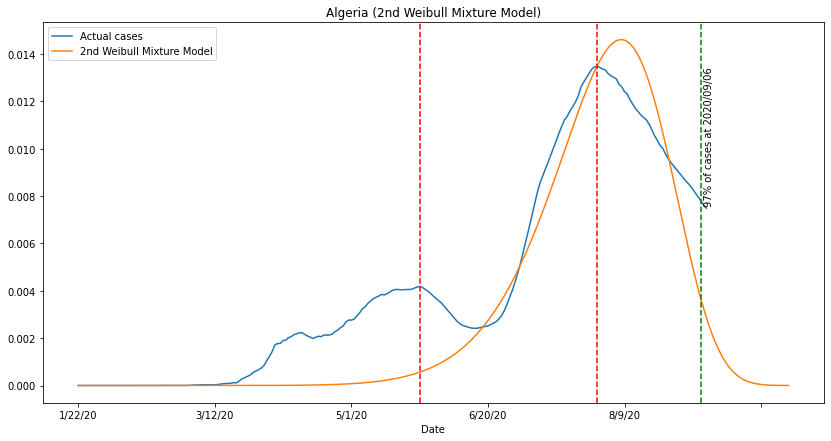

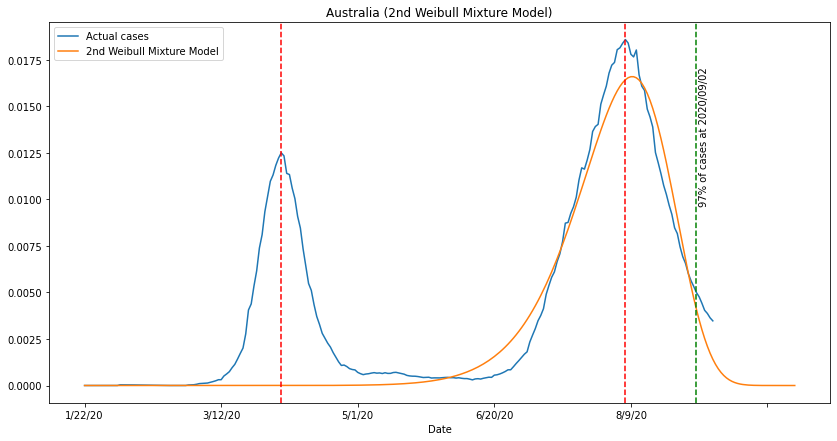

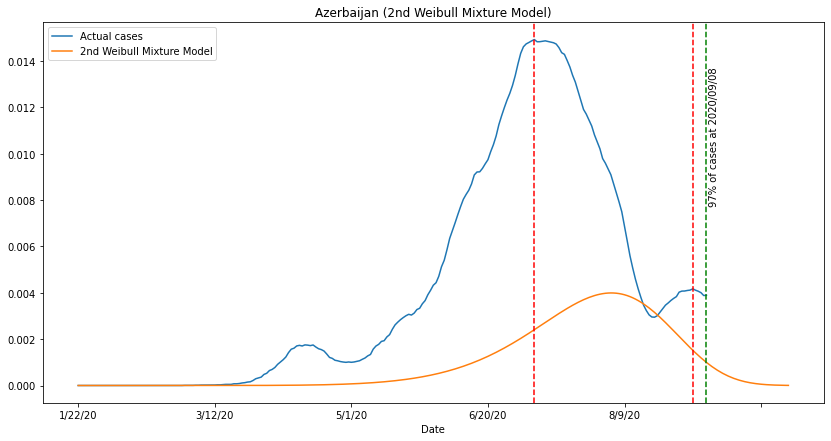

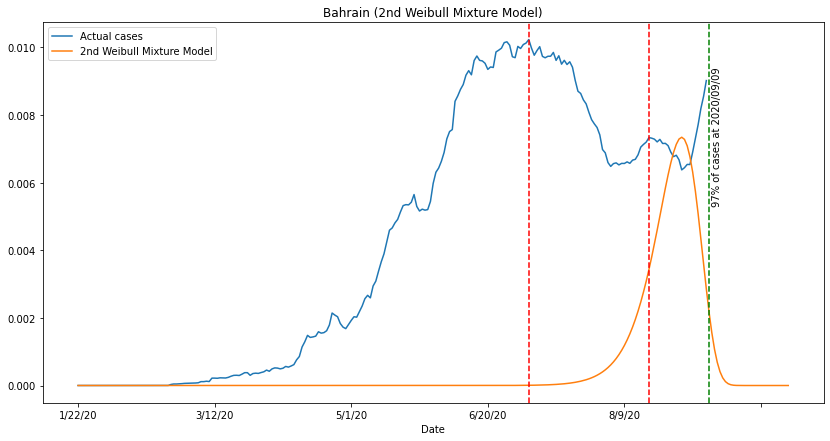

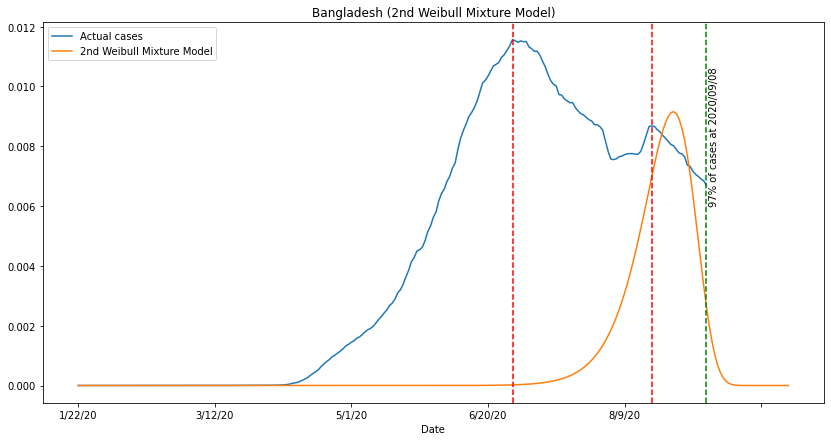

...

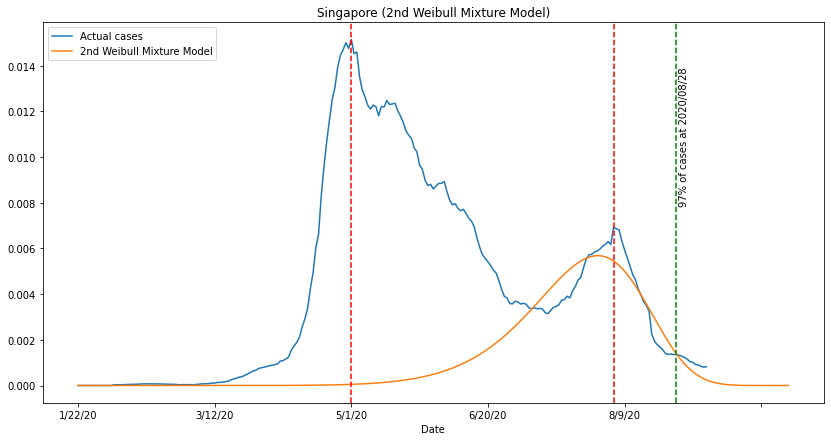

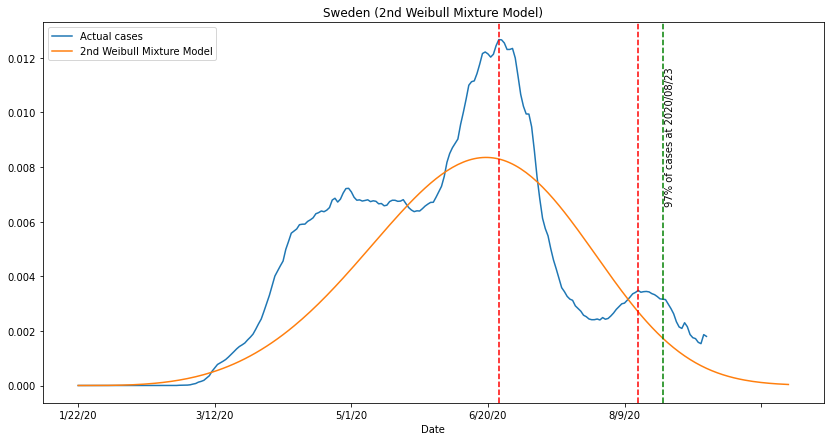

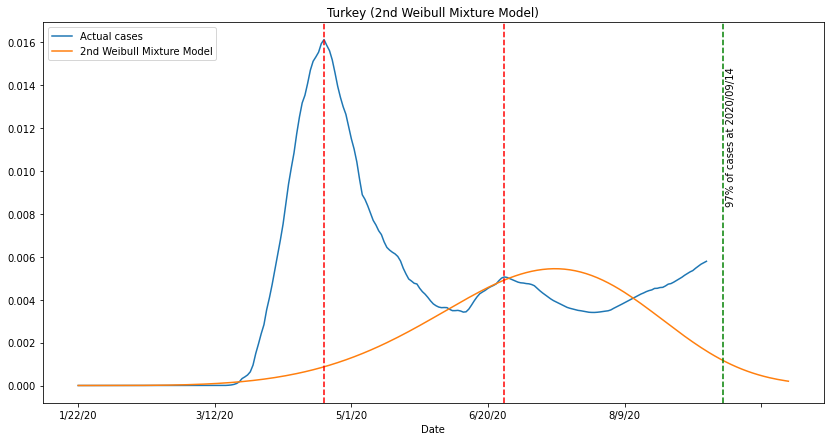

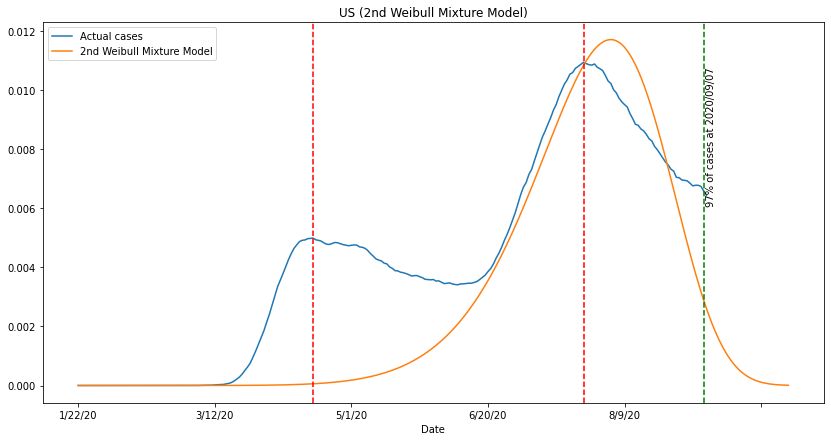

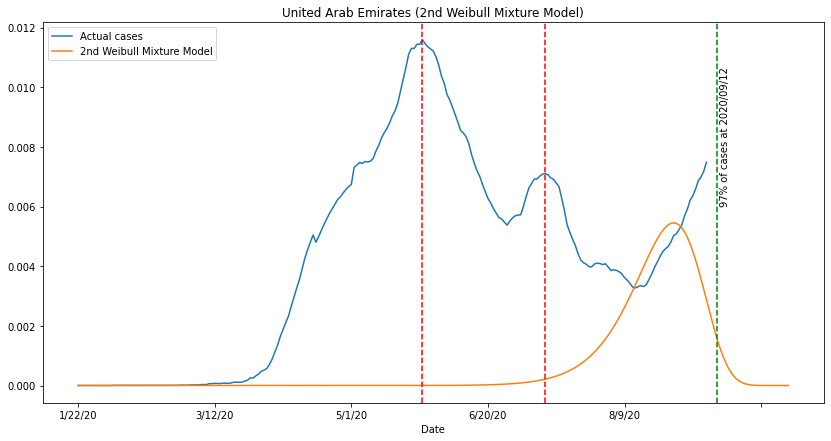

In [270]:
x = np.linspace(0,df_by_country_increase.shape[0]-1+30,df_by_country_increase.shape[0]+30)
for country in df_country_prob['2w_params'].items():
    plt.figure(figsize=(14,7))
    country_prob_dist = (df_by_country_increase[country[0]].rolling(window=14).mean().fillna(0)/np.round(df_by_country_increase[country[0]].rolling(window=14).mean().fillna(0), 0).sum())
    country_prob_dist.plot(kind='line')
    
    weibull_alpha_2 = country[1][3]
    weibull_beta_2 = country[1][4]
    weibull_proportion_2 = country[1][5]
    dist = Weibull_Distribution(alpha=weibull_alpha_2,beta=weibull_beta_2)
    dist_pdf_scale = dist.PDF(xvals=x, show_plot=False)*weibull_proportion_2
    plt.plot(dist_pdf_scale)
    time_freq_res_cdf = dist.CDF(xvals=x, show_plot=False)
    cdf_thresh = 0.97 # predict 97% of cases
    cdf_thresh_day = np.abs(time_freq_res_cdf-cdf_thresh).argmin()
    
    plt.axvline(x=cdf_thresh_day, color='g',linestyle='--')
    plt.text(cdf_thresh_day+1, plt.ylim()[1]*0.5, '97% of cases at '+(date(2020,1,22)+timedelta(days=int(cdf_thresh_day))).strftime('%Y/%m/%d'), rotation=90)
    plt.title(country[0]+' (2nd Weibull Mixture Model)')
    plt.legend(['Actual cases','2nd Weibull Mixture Model'], loc='upper left')
    
    for peak in df_country_peaks.loc[[country[0]]]['peaks_case_filter'].values[0]:
        plt.axvline(x=peak[0],color='r',linestyle='--')
    plt.savefig('./output-2ndweibull/'+country[0]+'.jpg')

In [271]:
(df_2nd_wave_97p_date['date']).sort_index()

country
Algeria                 2020-09-06
Australia               2020-09-02
Azerbaijan              2020-09-08
Bahrain                 2020-09-09
Bangladesh              2020-09-08
Belgium                 2020-09-09
Brazil                  2020-09-09
Cameroon                2020-09-09
Canada                  2020-09-11
Congo (Kinshasa)        2020-09-04
Cote d'Ivoire           2020-09-09
Denmark                 2020-09-11
Equatorial Guinea       2020-08-24
Gabon                   2020-08-30
Guatemala               2020-09-08
Honduras                2020-09-09
Israel                  2020-09-02
Japan                   2020-09-06
Kazakhstan              2020-08-20
Kuwait                  2020-09-09
Luxembourg              2020-09-04
Moldova                 2020-09-09
North Macedonia         2020-09-08
Peru                    2020-09-09
Portugal                2020-09-09
Romania                 2020-09-10
Saudi Arabia            2020-09-04
Senegal                 2020-09-07
Serbia      

In [255]:
(df_2nd_wave_97p_date['date']-date.today()).sort_values()

country
Kazakhstan             -22 days
Sweden                 -19 days
Equatorial Guinea      -18 days
Singapore              -14 days
Gabon                  -12 days
Serbia                 -10 days
Israel                  -9 days
Australia               -9 days
Saudi Arabia            -7 days
Luxembourg              -7 days
Congo (Kinshasa)        -7 days
Japan                   -5 days
Algeria                 -5 days
US                      -4 days
Senegal                 -4 days
Guatemala               -3 days
Azerbaijan              -3 days
Bangladesh              -3 days
North Macedonia         -3 days
Cote d'Ivoire           -2 days
Bahrain                 -2 days
Belgium                 -2 days
Portugal                -2 days
Peru                    -2 days
Moldova                 -2 days
Brazil                  -2 days
Kuwait                  -2 days
Cameroon                -2 days
Honduras                -2 days
Romania                 -1 days
Canada                   0 days


Index(['Algeria', 'Australia', 'Azerbaijan', 'Bahrain', 'Bangladesh', 'Belgium', 'Brazil', 'Cameroon', 'Canada', 'Congo (Kinshasa)', 'Cote d'Ivoire', 'Denmark', 'Equatorial Guinea', 'Gabon',
       'Guatemala', 'Honduras', 'Israel', 'Japan', 'Kazakhstan', 'Kuwait', 'Luxembourg', 'Moldova', 'North Macedonia', 'Peru', 'Portugal', 'Romania', 'Saudi Arabia', 'Senegal', 'Serbia', 'Singapore',
       'Sweden', 'Turkey', 'US', 'United Arab Emirates'],
      dtype='object', name='Country/Region')

In [105]:
time_freq_jp_res.results

,Point Estimate,Standard Error,Lower CI,Upper CI
Parameter,,,,
Alpha 1,107.771715,0.030746,107.711472,107.831992
Beta 1,5.558939,0.004881,5.549381,5.568514
Alpha 2,197.831382,0.014490,197.802985,197.859783
Beta 2,8.564744,0.004835,8.555274,8.574225
Proportion 1,0.270012,0.000247,0.269528,0.270497


In [ ]:
df_country_peaks[df_country_peaks['no_peaks']==2]

In [117]:
time_freq_jp_res.

In [101]:
Fit_Weibull_Mixture?

In [41]:
df_country_peaks[df_country_peaks['incr_ratio_2w_now']>1.6].count()

country              65
peaks_index          65
incr_ratio_2w_now    65
peaks_date           65
peaks_case           65
peaks_case_zip       65
current_growth       65
peaks_case_filter    65
no_peaks             65
dtype: int64

<Figure size 1008x504 with 0 Axes>

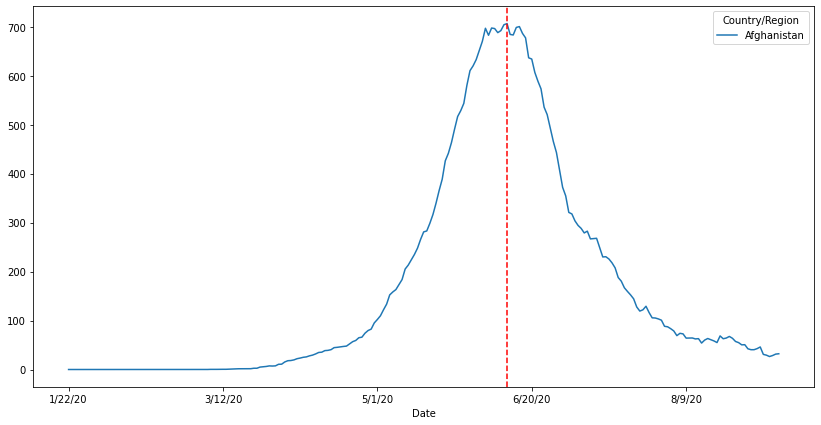

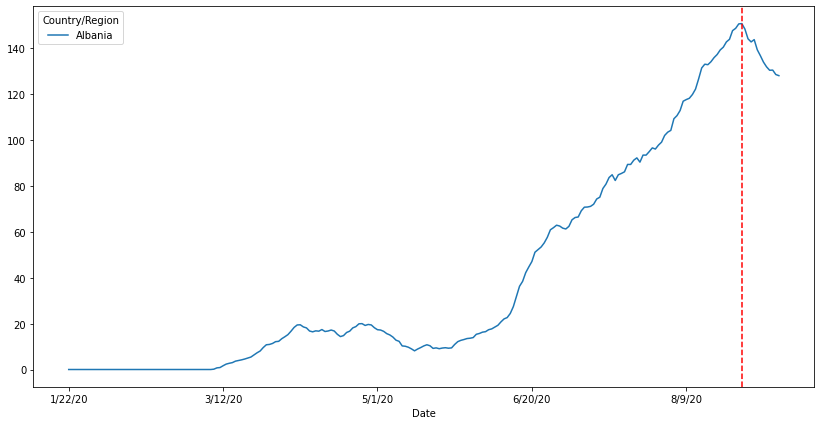

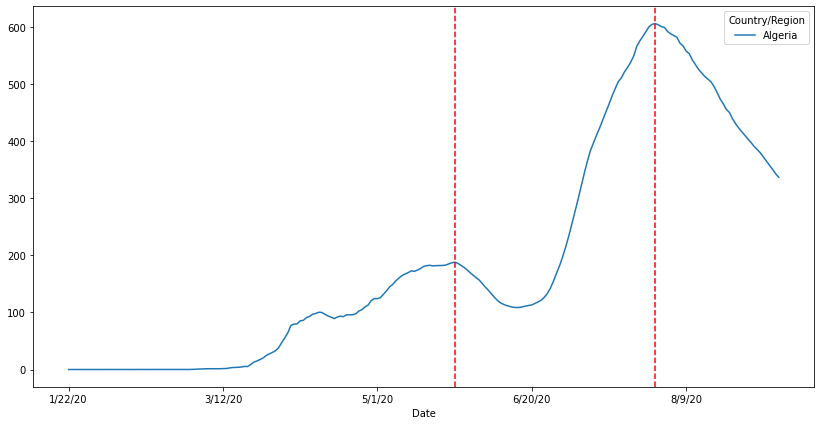

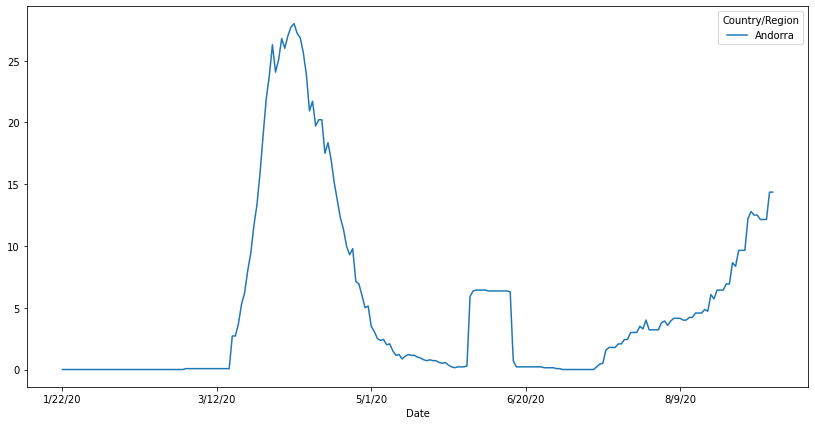

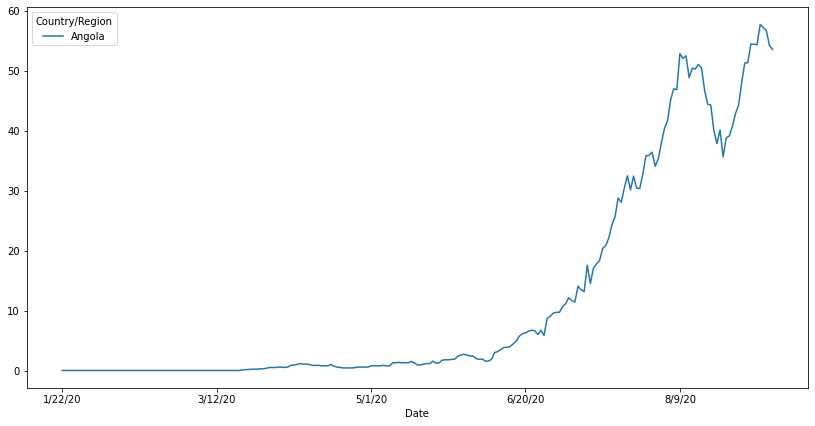

...

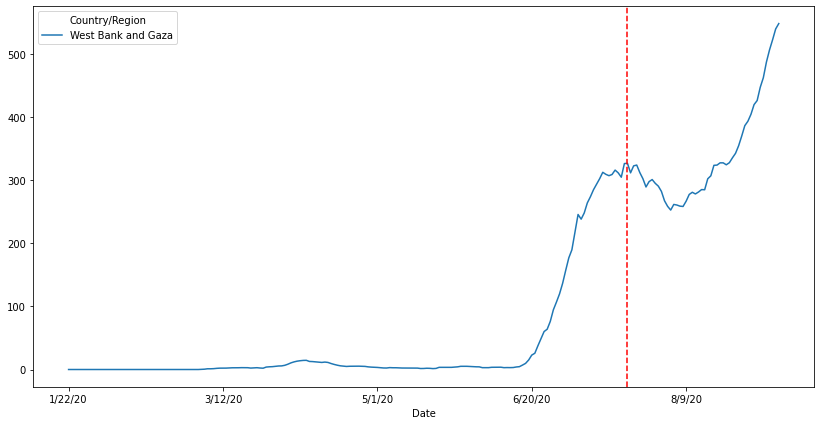

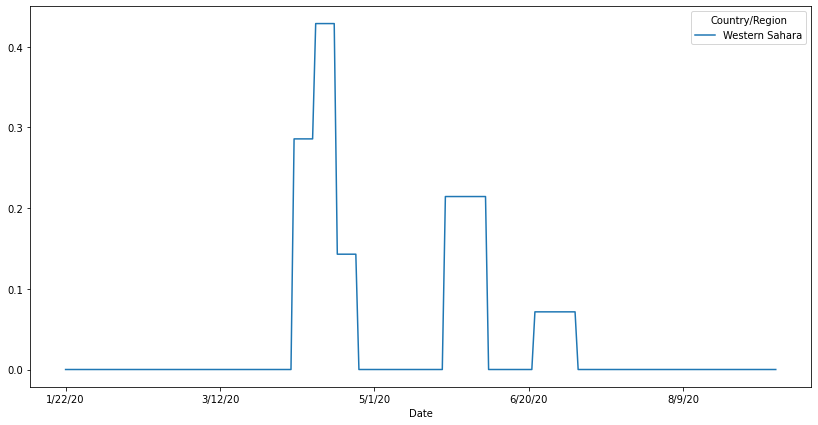

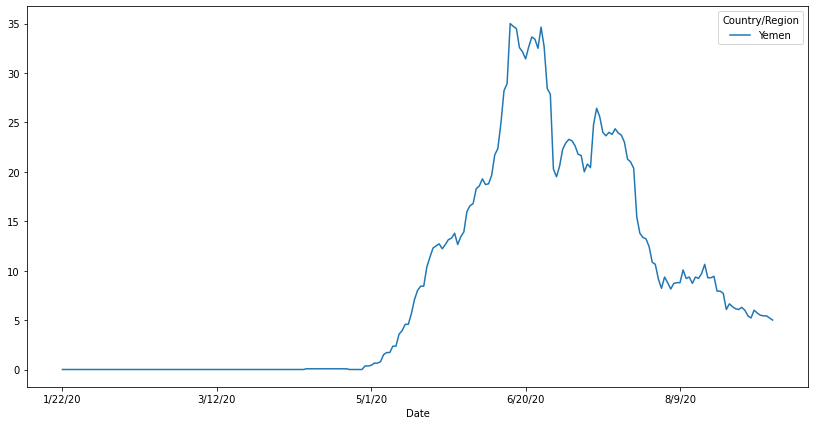

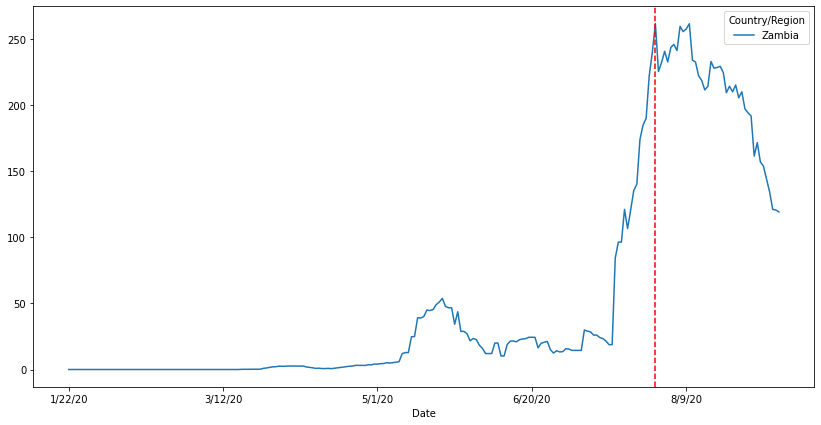

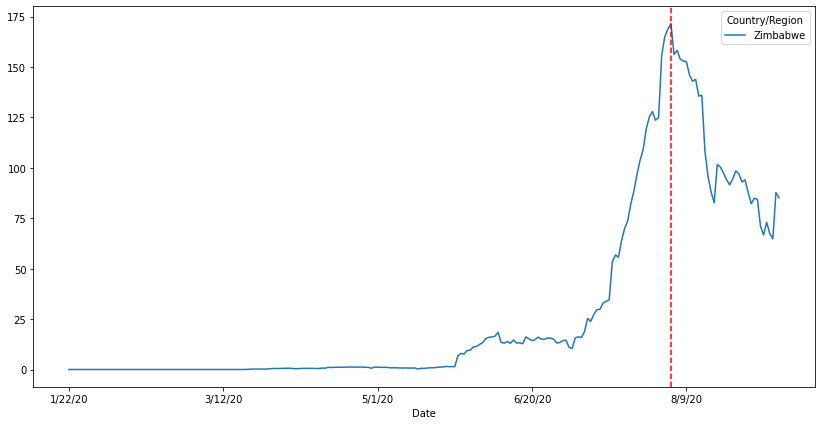

In [204]:
plt.figure(figsize=(14,7))
for country in df_by_country_increase.columns.values:
    df_by_country_increase_rolling[[country]].plot(kind='line',figsize=(14,7))
#     plt.axvline(x=df_by_country_increase_rolling.shape[0]-14, color='g',linestyle='--')
#     plt.axvline(x=df_by_country_increase_rolling.shape[0]-60, color='g',linestyle='--')
    for peak in df_country_peaks.loc[[country]]['peaks_case_filter'].values[0]:
        plt.axvline(x=peak[0],color='r',linestyle='--')
    plt.savefig('./output-no-neg-incr-roll14/'+country+'.jpg')

<Figure size 1008x504 with 0 Axes>

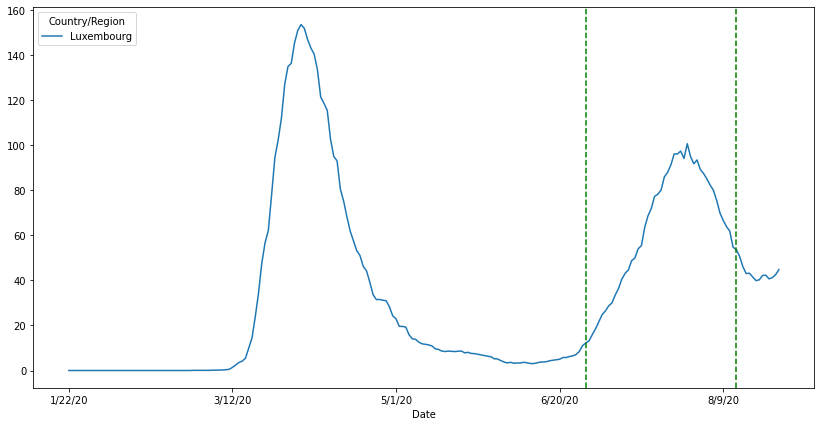

In [57]:
plt.figure(figsize=(14,7))
for country in ['Luxembourg']:#df_by_country_increase.columns.values:
    df_by_country_increase_rolling[[country]].plot(kind='line',figsize=(14,7))
    plt.axvline(x=df_by_country_increase_rolling.shape[0]-14, color='g',linestyle='--')
    plt.axvline(x=df_by_country_increase_rolling.shape[0]-60, color='g',linestyle='--')
#     for peak in df_country_peaks.loc[[country]]['peaks_case_filter'].values[0]:
#         plt.axvline(x=peak[0],color='r',linestyle='--')
#     plt.savefig('./output-no-neg-incr-roll14/'+country+'.jpg')

In [26]:
print(df_country_peaks[df_country_peaks['no_peaks']==0][['country']].to_string())

                                                           country
Country/Region                                                    
Albania                                                    Albania
Andorra                                                    Andorra
Angola                                                      Angola
Antigua and Barbuda                            Antigua and Barbuda
Argentina                                                Argentina
Bahamas                                                    Bahamas
Barbados                                                  Barbados
Belize                                                      Belize
Benin                                                        Benin
Bhutan                                                      Bhutan
Botswana                                                  Botswana
Brunei                                                      Brunei
Burkina Faso                                          Burkina 

In [99]:
df_country_peaks.loc['Colombia']

country                    Colombia
peaks_index                      []
increasing_ratio_4w_2w      1.77404
increasing_ratio_2w_now     2.11696
peaks_date                       []
peaks_case                       []
peaks_case_zip                   []
current_growth                   []
peaks_case_filter                []
no_peaks                          0
Name: Colombia, dtype: object

In [94]:
((df_by_country_increase_rolling[-15:].mean()+1)/(df_by_country_increase_rolling[-30:-15].mean()+1)).sort_values()

Country/Region
Equatorial Guinea        0.211410
Sao Tome and Principe    0.243703
Oman                     0.305332
Kyrgyzstan               0.350221
Egypt                    0.354860
                           ...   
Tunisia                  3.654153
New Zealand              3.680905
Uganda                   4.069231
Trinidad and Tobago      6.677083
Belize                   7.058140
Length: 188, dtype: float64

In [87]:
df_country_peaks[['country','no_peaks']].groupby('no_peaks').count()

,country
no_peaks,
0,97
1,52
2,36
3,2
4,1


In [59]:
df_country_peaks[['country','no_peaks','trend']].groupby(['no_peaks','trend']).count()

country
no_peaks trend                         
0        Constant/Inconclusive       38
         Decreasing                  16
         Increasing                  43
1        Constant/Inconclusive       25
         Decreasing                  14
         Increasing                  13
2        Constant/Inconclusive       19
         Decreasing                   9
         Increasing                   8
3        Decreasing                   1
         Increasing                   1
4        Constant/Inconclusive        1

In [63]:
df_country_peaks[(df_country_peaks['no_peaks']==3)&(df_country_peaks['trend']=='Increasing')]

,country,peaks_index,incr_ratio_2w_now,peaks_date,peaks_case,peaks_case_zip,current_growth,peaks_case_filter,trend,no_peaks
Country/Region,,,,,,,,,,
Poland,Poland,"[88, 123, 147]",1.836635,"[4/19/20, 5/24/20, 6/17/20]","[370.35714285714283, 380.7142857142857, 429.57...","[(88, 4/19/20, 370.35714285714283), (123, 5/24...","[(88, 4/19/20, 370.35714285714283), (123, 5/24...","[(88, 4/19/20, 370.35714285714283), (123, 5/24...",Increasing,3


In [65]:
df_country_peaks[(df_country_peaks['no_peaks']==1)&(df_country_peaks['trend']=='Increasing')]

,country,peaks_index,incr_ratio_2w_now,peaks_date,peaks_case,peaks_case_zip,current_growth,peaks_case_filter,trend,no_peaks
Country/Region,,,,,,,,,,
Austria,Austria,"[72, 118, 189]",1.987005,"[4/3/20, 5/19/20, 7/29/20]","[652.5714285714286, 47.92857142857143, 121.142...","[(72, 4/3/20, 652.5714285714286), (118, 5/19/2...","[(72, 4/3/20, 652.5714285714286), (118, 5/19/2...","[(72, 4/3/20, 652.5714285714286)]",Increasing,1
Ethiopia,Ethiopia,"[87, 89, 150]",2.924886,"[4/18/20, 4/20/20, 6/20/20]","[4.785714285714286, 4.785714285714286, 181.071...","[(87, 4/18/20, 4.785714285714286), (89, 4/20/2...","[(87, 4/18/20, 4.785714285714286), (89, 4/20/2...","[(150, 6/20/20, 181.07142857142858)]",Increasing,1
Finland,Finland,"[16, 86]",2.440863,"[2/7/20, 4/17/20]","[0.07142857142857142, 133.85714285714286]","[(16, 2/7/20, 0.07142857142857142), (86, 4/17/...","[(16, 2/7/20, 0.07142857142857142), (86, 4/17/...","[(86, 4/17/20, 133.85714285714286)]",Increasing,1
France,France,"[18, 85, 140]",3.177651,"[2/9/20, 4/16/20, 6/10/20]","[0.5714285714285714, 6153.285714285715, 723.0]","[(18, 2/9/20, 0.5714285714285714), (85, 4/16/2...","[(18, 2/9/20, 0.5714285714285714), (85, 4/16/2...","[(85, 4/16/20, 6153.285714285715)]",Increasing,1
Germany,Germany,"[18, 77, 159]",2.171497,"[2/9/20, 4/8/20, 6/29/20]","[1.0, 5426.642857142857, 525.7142857142857]","[(18, 2/9/20, 1.0), (77, 4/8/20, 5426.64285714...","[(18, 2/9/20, 1.0), (77, 4/8/20, 5426.64285714...","[(77, 4/8/20, 5426.642857142857)]",Increasing,1
Ireland,Ireland,[92],3.720490,[4/23/20],[788.0714285714286],"[(92, 4/23/20, 788.0714285714286)]","[(92, 4/23/20, 788.0714285714286)]","[(92, 4/23/20, 788.0714285714286)]",Increasing,1
Italy,Italy,"[19, 70]",2.211149,"[2/10/20, 4/1/20]","[0.21428571428571427, 5347.214285714285]","[(19, 2/10/20, 0.21428571428571427), (70, 4/1/...","[(19, 2/10/20, 0.21428571428571427), (70, 4/1/...","[(70, 4/1/20, 5347.214285714285)]",Increasing,1
"Korea, South","Korea, South","[21, 46, 169]",3.229833,"[2/12/20, 3/8/20, 7/9/20]","[1.7142857142857142, 479.42857142857144, 52.57...","[(21, 2/12/20, 1.7142857142857142), (46, 3/8/2...","[(21, 2/12/20, 1.7142857142857142), (46, 3/8/2...","[(46, 3/8/20, 479.42857142857144)]",Increasing,1
Nepal,Nepal,"[98, 159]",1.966680,"[4/29/20, 6/29/20]","[2.9285714285714284, 502.64285714285717]","[(98, 4/29/20, 2.9285714285714284), (159, 6/29...","[(98, 4/29/20, 2.9285714285714284), (159, 6/29...","[(159, 6/29/20, 502.64285714285717)]",Increasing,1


In [55]:
df_country_peaks[df_country_peaks['no_peaks']>=2][['country','no_peaks']]

,country,no_peaks
2,Algeria,2
8,Australia,2
12,Bahrain,2
16,Belgium,2
23,Brazil,2
31,Cameroon,2
32,Canada,2
40,Congo (Kinshasa),2
42,Cote d'Ivoire,2
46,Czechia,2


In [102]:
df_country_peaks[df_country_peaks['no_peaks']==0]

,country,peaks_index,increasing_ratio_2w_now,peaks_date,peaks_case,peaks_case_zip,current_growth,peaks_case_filter,no_peaks
Country/Region,,,,,,,,,
Albania,Albania,[95],1.575010,[4/26/20],[20.0],"[(95, 4/26/20, 20.0)]","[(95, 4/26/20, 20.0)]",[],0
Andorra,Andorra,"[75, 135]",2.296894,"[4/6/20, 6/5/20]","[28.0, 6.428571428571429]","[(75, 4/6/20, 28.0), (135, 6/5/20, 6.428571428...","[(75, 4/6/20, 28.0), (135, 6/5/20, 6.428571428...",[],0
Angola,Angola,"[77, 113, 200]",1.578632,"[4/8/20, 5/14/20, 8/9/20]","[1.1428571428571428, 1.5, 52.857142857142854]","[(77, 4/8/20, 1.1428571428571428), (113, 5/14/...","[(77, 4/8/20, 1.1428571428571428), (113, 5/14/...",[],0
Antigua and Barbuda,Antigua and Barbuda,"[76, 83, 136, 167, 189]",0.497018,"[4/7/20, 4/14/20, 6/6/20, 7/7/20, 7/29/20]","[1.1428571428571428, 1.1428571428571428, 0.071...","[(76, 4/7/20, 1.1428571428571428), (83, 4/14/2...","[(76, 4/7/20, 1.1428571428571428), (83, 4/14/2...",[],0
Argentina,Argentina,[],1.698615,[],[],[],[],[],0
...,...,...,...,...,...,...,...,...,...
Venezuela,Venezuela,"[68, 94]",2.332436,"[3/30/20, 4/25/20]","[8.428571428571429, 10.571428571428571]","[(68, 3/30/20, 8.428571428571429), (94, 4/25/2...","[(68, 3/30/20, 8.428571428571429), (94, 4/25/2...",[],0
Vietnam,Vietnam,"[22, 71, 118, 149, 158, 203]",2.189736,"[2/13/20, 4/2/20, 5/19/20, 6/19/20, 6/28/20, 8...","[1.0, 10.571428571428571, 3.7857142857142856, ...","[(22, 2/13/20, 1.0), (71, 4/2/20, 10.571428571...","[(22, 2/13/20, 1.0), (71, 4/2/20, 10.571428571...",[],0
Western Sahara,Western Sahara,"[84, 129, 158]",0.987730,"[4/15/20, 5/30/20, 6/28/20]","[0.42857142857142855, 0.21428571428571427, 0.0...","[(84, 4/15/20, 0.42857142857142855), (129, 5/3...","[(84, 4/15/20, 0.42857142857142855), (129, 5/3...",[],0


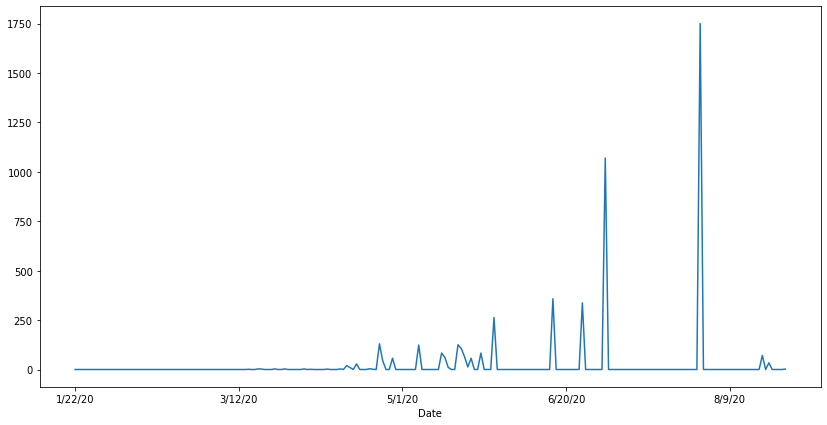

In [36]:
df_by_country_increase['Equatorial Guinea'].plot(kind='line',figsize=(14,7))

In [27]:
print(df_by_country_increase['Equatorial Guinea'].to_string())

Date
1/22/20       0.0
1/23/20       0.0
1/24/20       0.0
1/25/20       0.0
1/26/20       0.0
1/27/20       0.0
1/28/20       0.0
1/29/20       0.0
1/30/20       0.0
1/31/20       0.0
2/1/20        0.0
2/2/20        0.0
2/3/20        0.0
2/4/20        0.0
2/5/20        0.0
2/6/20        0.0
2/7/20        0.0
2/8/20        0.0
2/9/20        0.0
2/10/20       0.0
2/11/20       0.0
2/12/20       0.0
2/13/20       0.0
2/14/20       0.0
2/15/20       0.0
2/16/20       0.0
2/17/20       0.0
2/18/20       0.0
2/19/20       0.0
2/20/20       0.0
2/21/20       0.0
2/22/20       0.0
2/23/20       0.0
2/24/20       0.0
2/25/20       0.0
2/26/20       0.0
2/27/20       0.0
2/28/20       0.0
2/29/20       0.0
3/1/20        0.0
3/2/20        0.0
3/3/20        0.0
3/4/20        0.0
3/5/20        0.0
3/6/20        0.0
3/7/20        0.0
3/8/20        0.0
3/9/20        0.0
3/10/20       0.0
3/11/20       0.0
3/12/20       0.0
3/13/20       0.0
3/14/20       0.0
3/15/20       1.0
3/16/20       0.0
3/17/

In [59]:
# TODO: Iran constant but counted as 3 waves
df_country_peaks[df_country_peaks['country']=='Iran'] 

,country,peaks_index,peaks_date,peaks_case,peaks_case_filter,no_peaks
81,Iran,"[76, 139, 168, 197]","[4/7/20, 6/9/20, 7/8/20, 8/6/20]","[2698.4285714285716, 2601.1428571428573, 2562....","[2698.4285714285716, 2601.1428571428573, 2562....",4


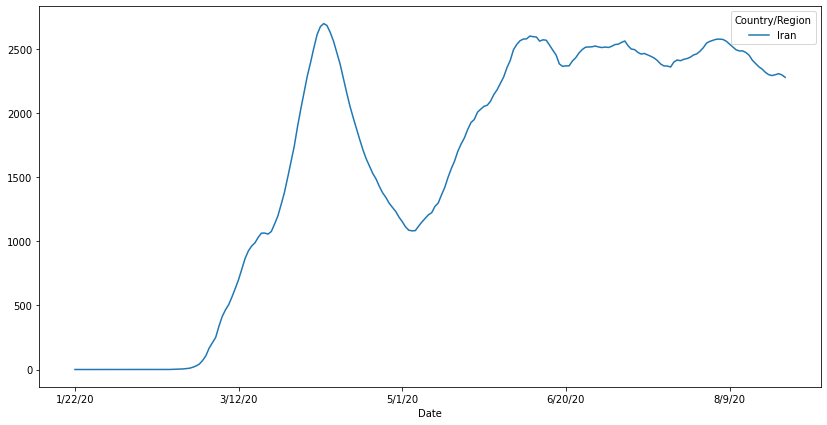

In [58]:
df_by_country_increase[['Iran']].rolling(window=14).mean().fillna(0).plot(kind='line',figsize=(14,7))

In [92]:
signal.find_peaks(df_by_country_increase_rolling['Ghana'], width=7)

(array([], dtype=int64),
 {'prominences': array([], dtype=float64),
  'left_bases': array([], dtype=int64),
  'right_bases': array([], dtype=int64),
  'widths': array([], dtype=float64),
  'width_heights': array([], dtype=float64),
  'left_ips': array([], dtype=float64),
  'right_ips': array([], dtype=float64)})

In [147]:
df_by_country_increase_rolling.T.loc['Algeria'][['2/10/20','3/10/20']].values

array([0.        , 1.35714286])

0                                    [706.2142857142857]
1                                                 [20.0]
2                [187.85714285714286, 605.4285714285714]
3                              [28.0, 6.428571428571429]
4                                                     []
                             ...                        
183              [14.571428571428571, 327.2142857142857]
184    [0.42857142857142855, 0.21428571428571427, 0.0...
185                          [0.07142857142857142, 35.0]
186                                 [53.785714285714285]
187    [1.2142857142857142, 1.2142857142857142, 1.214...
Length: 188, dtype: object

In [124]:
df_by_country_increase.T

Date,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,...,8/15/20,8/16/20,8/17/20,8/18/20,8/19/20,8/20/20,8/21/20,8/22/20,8/23/20,8/24/20
Country/Region,,,,,,,,,,,,,,,,,,,,,
Afghanistan,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,120.0,45.0,3.0,0.0,0.0,257.0,38.0,59.0,46.0,55.0
Albania,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,143.0,120.0,119.0,155.0,158.0,155.0,152.0,156.0,152.0,178.0
Algeria,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,469.0,450.0,442.0,419.0,403.0,411.0,409.0,401.0,392.0,398.0
Andorra,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,16.0,0.0,19.0,0.0,21.0,0.0,0.0,15.0
Angola,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,27.0,27.0,29.0,31.0,49.0,29.0,24.0,66.0,37.0,51.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
West Bank and Gaza,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,319.0,381.0,310.0,462.0,300.0,383.0,324.0,163.0,326.0,411.0
Western Sahara,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Yemen,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,11.0,13.0,7.0,3.0,7.0,7.0,1.0,4.0,5.0


In [100]:
print(df_country_peaks[['no_peaks']].to_string())

                                  no_peaks
country                                   
Afghanistan                              1
Albania                                  1
Algeria                                  2
Andorra                                  2
Angola                                   0
Antigua and Barbuda                      4
Argentina                                0
Armenia                                  1
Australia                                2
Austria                                  1
Azerbaijan                               2
Bahamas                                  1
Bahrain                                  1
Bangladesh                               1
Barbados                                 2
Belarus                                  1
Belgium                                  2
Belize                                   1
Benin                                    2
Bhutan                                   1
Bolivia                                  1
Bosnia and 

In [30]:
signal.find_peaks(df_by_country_increase_rolling_scale['US'].rolling(window=14).mean(),width=14)

(array([ 94, 193]),
 {'prominences': array([0.13052571, 0.21607425]),
  'left_bases': array([13, 13]),
  'right_bases': array([146, 215]),
  'widths': array([34.21054749, 23.8970105 ]),
  'width_heights': array([0.38131337, 0.8751537 ]),
  'left_ips': array([ 84.07522051, 181.96449502]),
  'right_ips': array([118.285768  , 205.86150552])})